In [1]:
#Basic Libraries
import numpy as np
import pandas as pd
#Visualization Libraries
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
#Text Handling Libraries
import re
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.metrics.pairwise import cosine_similarity

In [2]:
history_df = pd.read_parquet(r'C:\Users\bilba\Downloads\ebnerd_large (1)\train\history.parquet', engine='pyarrow')
behaviors_df = pd.read_parquet(r'C:\Users\bilba\Downloads\ebnerd_large (1)\train\behaviors.parquet', engine='pyarrow')
articles_df = pd.read_parquet(r'C:\Users\bilba\Downloads\ebnerd_large (1)\articles.parquet', engine='pyarrow')

## EDA (Exploratory Data Analysis) & Data Cleaning

In [3]:
print(history_df.shape)

print('Null Data Count In Each Column')
print('-'*30)
print(history_df.isnull().sum())
print('-'*30)
print('Null Data % In Each Column')
print('-'*30)
for col in history_df.columns:
    null_count = history_df[col].isnull().sum()
    total_count = history_df.shape[0]
    print("{} : {:.2f}".format(col,null_count/total_count * 100))

history_df.head(3)

(788090, 5)
Null Data Count In Each Column
------------------------------
user_id                    0
impression_time_fixed      0
scroll_percentage_fixed    0
article_id_fixed           0
read_time_fixed            0
dtype: int64
------------------------------
Null Data % In Each Column
------------------------------
user_id : 0.00
impression_time_fixed : 0.00
scroll_percentage_fixed : 0.00
article_id_fixed : 0.00
read_time_fixed : 0.00


,user_id,impression_time_fixed,scroll_percentage_fixed,article_id_fixed,read_time_fixed
0,10029,"[2023-04-28T06:16:57.000000, 2023-04-28T06:17:...","[23.0, 69.0, 27.0, nan, 47.0, 38.0, 100.0, 12....","[9735579, 9739888, 9739471, 9739864, 9738441, ...","[28.0, 24.0, 11.0, 107.0, 8.0, 7.0, 20.0, 5.0,..."
1,10033,"[2023-04-27T11:11:32.000000, 2023-04-27T11:12:...","[33.0, 41.0, 33.0, 100.0, 68.0, 38.0, 1.0, 58....","[9738139, 9738263, 9738139, 9738760, 9738777, ...","[2.0, 2.0, 718.0, 18.0, 26.0, 78.0, 3.0, 11.0,..."
2,10034,"[2023-04-30T09:46:57.000000, 2023-04-30T09:47:...","[nan, 88.0, 27.0, nan, 23.0, 100.0, 100.0, 22....","[9742693, 9742686, 9744016, 9743818, 9744922, ...","[21.0, 103.0, 28.0, 0.0, 5.0, 34.0, 14.0, 14.0..."


In [4]:
print(behaviors_df.shape)

print('Null Data Count In Each Column')
print('-'*30)
print(behaviors_df.isnull().sum())
print('-'*30)
print('Null Data % In Each Column')
print('-'*30)
for col in behaviors_df.columns:
    null_count = behaviors_df[col].isnull().sum()
    total_count = behaviors_df.shape[0]
    print("{} : {:.2f}".format(col,null_count/total_count * 100))

behaviors_df.head(3)

(12063890, 17)
Null Data Count In Each Column
------------------------------
impression_id                    0
article_id                 8458027
impression_time                  0
read_time                        0
scroll_percentage          8523902
device_type                      0
article_ids_inview               0
article_ids_clicked              0
user_id                          0
is_sso_user                      0
gender                    11176907
postcode                  11795148
age                       11694243
is_subscriber                    0
session_id                       0
next_read_time              319928
next_scroll_percentage     1360982
dtype: int64
------------------------------
Null Data % In Each Column
------------------------------
impression_id : 0.00
article_id : 70.11
impression_time : 0.00
read_time : 0.00
scroll_percentage : 70.66
device_type : 0.00
article_ids_inview : 0.00
article_ids_clicked : 0.00
user_id : 0.00
is_sso_user : 0.00
gender : 92.65

,impression_id,article_id,impression_time,read_time,scroll_percentage,device_type,article_ids_inview,article_ids_clicked,user_id,is_sso_user,gender,postcode,age,is_subscriber,session_id,next_read_time,next_scroll_percentage
0,47727,NaN,2023-05-21 21:35:07,20.0,NaN,1,"[9482380, 9775183, 9744403, 9775297, 9774020, ...",[9775183],18293,False,NaN,NaN,NaN,False,265,34.0,100.0
1,47731,NaN,2023-05-21 21:32:33,13.0,NaN,1,"[9774557, 9774516, 9775331, 9775277, 9759966]",[9759966],18293,False,NaN,NaN,NaN,False,265,45.0,100.0
2,47736,NaN,2023-05-21 21:33:32,17.0,NaN,1,"[9759966, 9774557, 9775352, 9746360, 9772601, ...",[9774652],18293,False,NaN,NaN,NaN,False,265,78.0,100.0


In [5]:
print(articles_df.shape)

print('Null Data Count In Each Column')
print('-'*30)
print(articles_df.isnull().sum())
print('-'*30)
print('Null Data % In Each Column')
print('-'*30)
for col in articles_df.columns:
    null_count = articles_df[col].isnull().sum()
    total_count = articles_df.shape[0]
    print("{} : {:.2f}".format(col,null_count/total_count * 100))

articles_df.head(3)

(125541, 21)
Null Data Count In Each Column
------------------------------
article_id                 0
title                      0
subtitle                   0
last_modified_time         0
premium                    0
body                       0
published_time             0
image_ids              14322
article_type               0
url                        0
ner_clusters               0
entity_groups              0
topics                     0
category                   0
subcategory                0
category_str               0
total_inviews         107205
total_pageviews       108600
total_read_time       108600
sentiment_score            0
sentiment_label            0
dtype: int64
------------------------------
Null Data % In Each Column
------------------------------
article_id : 0.00
title : 0.00
subtitle : 0.00
last_modified_time : 0.00
premium : 0.00
body : 0.00
published_time : 0.00
image_ids : 11.41
article_type : 0.00
url : 0.00
ner_clusters : 0.00
entity_groups : 0.00
to

,article_id,title,subtitle,last_modified_time,premium,body,published_time,image_ids,article_type,url,...,entity_groups,topics,category,subcategory,category_str,total_inviews,total_pageviews,total_read_time,sentiment_score,sentiment_label
0,3000022,Hanks beskyldt for mishandling,Tom Hanks har angiveligt mishandlet sin afdøde...,2023-06-29 06:20:32,False,Tom Hanks skulle angiveligt have mishandlet si...,2006-09-20 09:24:18,[3518381],article_default,https://ekstrabladet.dk/underholdning/udlandke...,...,[PER],"[Kriminalitet, Kendt, Underholdning, Personfar...",414,[432],underholdning,NaN,NaN,NaN,0.9911,Negative
1,3000063,Bostrups aske spredt i Furesøen,Studieværten blev mindet med glad festlighed,2023-06-29 06:20:32,False,Strålende sensommersol. Jazzede toner. Glas me...,2006-09-24 07:45:30,"[3170935, 3170939]",article_default,https://ekstrabladet.dk/nyheder/samfund/articl...,...,[],"[Kendt, Underholdning, Begivenhed, Personlig b...",118,[133],nyheder,NaN,NaN,NaN,0.5155,Neutral
2,3000613,Jesper Olsen ramt af hjerneblødning,Den tidligere danske landsholdsspiller i fodbo...,2023-06-29 06:20:33,False,"Jesper Olsen, der er noteret for 43 kampe på d...",2006-05-09 11:29:00,[3164998],article_default,https://ekstrabladet.dk/sport/fodbold/landshol...,...,"[LOC, PER, PER, PER]","[Kendt, Sport, Fodbold, Sundhed, Sygdom og beh...",142,"[196, 271]",sport,NaN,NaN,NaN,0.9876,Negative


I will drop the following columns due to them containing a high prevalence of nulls.

**Behaviors:**

    article_id : 70.11
    scroll_percentage : 70.66
    gender : 92.65
    postcode : 97.77
    age : 96.94

**Articles:**

    total_inviews : 85.39
    total_pageviews : 86.51
    total_read_time : 86.51


The features are important for our recommendation model, so we'll keep them. Perhaps, during further exploration, we may deem the columns to not provide enough information and may then drop them, and then we could reconsider if we should redo the .dropna function as we do lose a lot of rows thanks to these columns.

In [6]:
history_df = history_df.dropna()
print("history_df shape: ")
print(history_df.shape)
print("-"*30)
behaviors_df = behaviors_df.dropna()
print("behaviors_df shape: ")
print(behaviors_df.shape)
print("-"*30)
articles_df = articles_df.dropna()
print("articles shape: ")
print(articles_df.shape)


history_df shape: 
(788090, 5)
------------------------------
behaviors_df shape: 
(49662, 17)
------------------------------
articles shape: 
(14426, 21)


In [7]:
print("history_df data types: ")
print(history_df.dtypes)
print("\n")
print("-"*30)
print("\n")

print("behaviors_df data types: ")
print(behaviors_df.dtypes)
print("\n")
print("-"*30)
print("\n")

print("articles data types: ")
print(articles_df.dtypes)

history_df data types: 
user_id                    uint32
impression_time_fixed      object
scroll_percentage_fixed    object
article_id_fixed           object
read_time_fixed            object
dtype: object


------------------------------


behaviors_df data types: 
impression_id                     uint32
article_id                       float64
impression_time           datetime64[us]
read_time                        float32
scroll_percentage                float32
device_type                         int8
article_ids_inview                object
article_ids_clicked               object
user_id                           uint32
is_sso_user                         bool
gender                           float64
postcode                         float64
age                              float64
is_subscriber                       bool
session_id                        uint32
next_read_time                   float32
next_scroll_percentage           float32
dtype: object


------------------

## Univariate Analysis

## Articles Data

In [8]:
counts = articles_df['category_str'].value_counts()
count_percentage = articles_df['category_str'].value_counts(1)*100
counts_df = pd.DataFrame({'Category':counts.index,'Counts':counts.values,'Percent':np.round(count_percentage.values,2)})
display(counts_df)
px.bar(data_frame=counts_df,
 x='Category',
 y='Counts',
 color='Counts',
 color_continuous_scale='blues',
 text_auto=True,
 title=f'Count of Items in Each Category')

,Category,Counts,Percent
0,sport,3856,26.73
1,nyheder,3492,24.21
2,auto,2773,19.22
3,underholdning,1883,13.05
4,krimi,1097,7.60
5,nationen,376,2.61
6,forbrug,298,2.07
7,musik,217,1.50
8,penge,94,0.65
9,side9,89,0.62


In [9]:
counts = articles_df['sentiment_label'].value_counts()
count_percentage = articles_df['sentiment_label'].value_counts(1)*100
counts_df = pd.DataFrame({'Category':counts.index,'Counts':counts.values,'Percent':np.round(count_percentage.values,2)})
display(counts_df)
px.bar(data_frame=counts_df,
 x='Category',
 y='Counts',
 color='Counts',
 color_continuous_scale='blues',
 text_auto=True,
 title=f'Count of Items in Each Category')

,Category,Counts,Percent
0,Negative,6312,43.75
1,Neutral,4724,32.75
2,Positive,3390,23.50


## Behavior Data

In [10]:
counts = behaviors_df['gender'].value_counts()
count_percentage = behaviors_df['gender'].value_counts(1)*100
counts_df = pd.DataFrame({'Category':counts.index,'Counts':counts.values,'Percent':np.round(count_percentage.values,2)})
display(counts_df)
px.bar(data_frame=counts_df,
 x='Category',
 y='Counts',
 color='Counts',
 color_continuous_scale='blues',
 text_auto=True,
 title=f'Count of Items in Each Category')

,Category,Counts,Percent
0,0.0,42106,84.79
1,1.0,7556,15.21


In [11]:
counts = behaviors_df['age'].value_counts()
count_percentage = behaviors_df['age'].value_counts(1)*100
counts_df = pd.DataFrame({'Category':counts.index,'Counts':counts.values,'Percent':np.round(count_percentage.values,2)})
display(counts_df)
px.bar(data_frame=counts_df,
 x='Category',
 y='Counts',
 color='Counts',
 color_continuous_scale='blues',
 text_auto=True,
 title=f'Count of Items in Each Category')

,Category,Counts,Percent
0,60.0,14692,29.58
1,50.0,13123,26.42
2,70.0,11000,22.15
3,40.0,5678,11.43
4,80.0,2626,5.29
5,30.0,1590,3.20
6,20.0,470,0.95
7,0.0,269,0.54
8,90.0,167,0.34
9,10.0,47,0.09


In [12]:
counts = behaviors_df['postcode'].value_counts()
count_percentage = behaviors_df['postcode'].value_counts(1)*100
counts_df = pd.DataFrame({'Category':counts.index,'Counts':counts.values,'Percent':np.round(count_percentage.values,2)})
display(counts_df)
px.bar(data_frame=counts_df,
 x='Category',
 y='Counts',
 color='Counts',
 color_continuous_scale='blues',
 text_auto=True,
 title=f'Count of Items in Each Category')

,Category,Counts,Percent
0,0.0,18129,36.50
1,3.0,10489,21.12
2,1.0,8144,16.40
3,2.0,7863,15.83
4,4.0,5037,10.14


In [13]:
counts = behaviors_df['device_type'].value_counts()
count_percentage = behaviors_df['device_type'].value_counts(1)*100
counts_df = pd.DataFrame({'Category':counts.index,'Counts':counts.values,'Percent':np.round(count_percentage.values,2)})
display(counts_df)
px.bar(data_frame=counts_df,
 x='Category',
 y='Counts',
 color='Counts',
 color_continuous_scale='blues',
 text_auto=True,
 title=f'Count of Items in Each Category')

,Category,Counts,Percent
0,2,25100,50.54
1,1,22503,45.31
2,3,2059,4.15


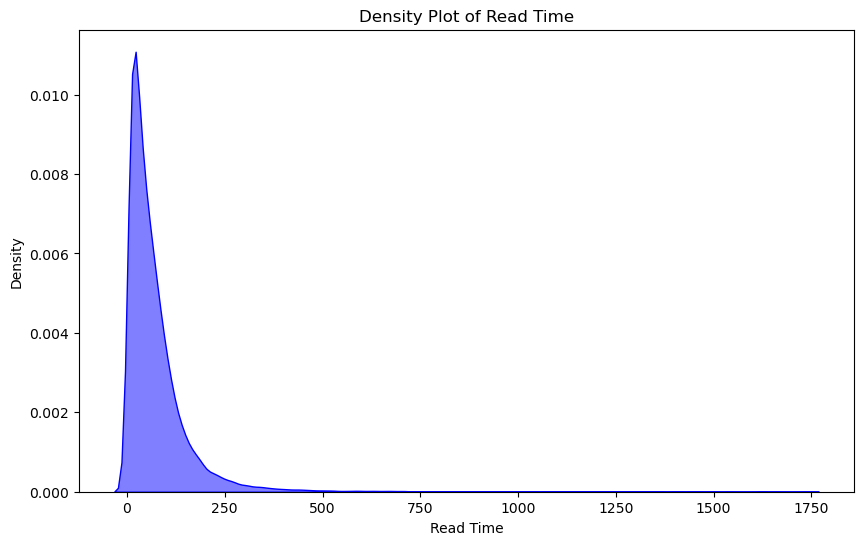

In [14]:
import seaborn as sns
import matplotlib.pyplot as plt

# KDE plot for the "read_time" column
plt.figure(figsize=(10, 6))
sns.kdeplot(data=behaviors_df, x='read_time', fill=True, alpha=0.5, color='blue')
plt.title('Density Plot of Read Time')
plt.xlabel('Read Time')
plt.ylabel('Density')
plt.show()

## history_df

In [15]:
history_df["read_time_fixed"]

0         [28.0, 24.0, 11.0, 107.0, 8.0, 7.0, 20.0, 5.0,...
1         [2.0, 2.0, 718.0, 18.0, 26.0, 78.0, 3.0, 11.0,...
2         [21.0, 103.0, 28.0, 0.0, 5.0, 34.0, 14.0, 14.0...
3         [12.0, 11.0, 3.0, 3.0, 4.0, 13.0, 29.0, 24.0, ...
4         [45.0, 8.0, 61.0, 72.0, 56.0, 3.0, 22.0, 16.0,...
                                ...                        
788085                  [18.0, 11.0, 17.0, 25.0, 13.0, 1.0]
788086                         [119.0, 3.0, 5.0, 33.0, 0.0]
788087    [14.0, 17.0, 23.0, 50.0, 33.0, 39.0, 16.0, 329...
788088    [11.0, 5.0, 4.0, 20.0, 2.0, 6.0, 2.0, 1.0, 3.0...
788089                    [18.0, 117.0, 115.0, 11.0, 359.0]
Name: read_time_fixed, Length: 788090, dtype: object

In [16]:
history_df["article_id_fixed"]

0         [9735579, 9739888, 9739471, 9739864, 9738441, ...
1         [9738139, 9738263, 9738139, 9738760, 9738777, ...
2         [9742693, 9742686, 9744016, 9743818, 9744922, ...
3         [9739035, 9738303, 9737243, 9739634, 9739802, ...
4         [9739035, 9739164, 9741803, 9740087, 9741986, ...
                                ...                        
788085    [9763579, 9763448, 9763398, 9763401, 9761588, ...
788086        [9758717, 9758538, 9758717, 9758074, 9758717]
788087    [9742619, 9742627, 9742586, 9742625, 9741144, ...
788088    [9757876, 9757857, 9757676, 9757639, 9757746, ...
788089        [9753603, 9753684, 9753668, 9750772, 9753521]
Name: article_id_fixed, Length: 788090, dtype: object

In [17]:
history_df["scroll_percentage_fixed"]

0         [23.0, 69.0, 27.0, nan, 47.0, 38.0, 100.0, 12....
1         [33.0, 41.0, 33.0, 100.0, 68.0, 38.0, 1.0, 58....
2         [nan, 88.0, 27.0, nan, 23.0, 100.0, 100.0, 22....
3         [78.0, 41.0, 4.0, 16.0, 22.0, 32.0, 11.0, 94.0...
4         [100.0, nan, 100.0, 100.0, 100.0, 28.0, 82.0, ...
                                ...                        
788085                 [50.0, 28.0, 13.0, 29.0, 28.0, 66.0]
788086                   [100.0, 56.0, 100.0, 100.0, 100.0]
788087    [70.0, 45.0, 67.0, 40.0, 51.0, 72.0, 50.0, 53....
788088    [91.0, 100.0, 71.0, 64.0, 61.0, 41.0, 49.0, 74...
788089                      [29.0, 100.0, 100.0, 4.0, 60.0]
Name: scroll_percentage_fixed, Length: 788090, dtype: object

In [18]:
history_df["user_id"]

0           10029
1           10033
2           10034
3           10041
4           10103
           ...   
788085    1802030
788086    2146107
788087    1200613
788088    1375724
788089    1541617
Name: user_id, Length: 788090, dtype: uint32

The **history_df["user_id"]** is where we'll find users with similar interests to then use implicit data to suggest another article to a user.

## Bivariate Analysis

In [19]:
behaviors_df.columns

Index(['impression_id', 'article_id', 'impression_time', 'read_time',
       'scroll_percentage', 'device_type', 'article_ids_inview',
       'article_ids_clicked', 'user_id', 'is_sso_user', 'gender', 'postcode',
       'age', 'is_subscriber', 'session_id', 'next_read_time',
       'next_scroll_percentage'],
      dtype='object')

In [20]:
articles_df.columns

Index(['article_id', 'title', 'subtitle', 'last_modified_time', 'premium',
       'body', 'published_time', 'image_ids', 'article_type', 'url',
       'ner_clusters', 'entity_groups', 'topics', 'category', 'subcategory',
       'category_str', 'total_inviews', 'total_pageviews', 'total_read_time',
       'sentiment_score', 'sentiment_label'],
      dtype='object')

In [21]:
artbeh_df = pd.merge(articles_df, behaviors_df, on='article_id', how='inner') #you could also combine with user id and then combine all 3 but idk


In [22]:
artbeh_df

,article_id,title,subtitle,last_modified_time,premium,body,published_time,image_ids,article_type,url,...,article_ids_clicked,user_id,is_sso_user,gender,postcode,age,is_subscriber,session_id,next_read_time,next_scroll_percentage
0,9582707,Dit helbreds bedste ven kan slå dig ihjel,- Årsagen til mindst hvert andet dødsfald i Da...,2023-06-29 06:46:09,True,Immunforsvarets funktion er ikke kun at bekæmp...,2023-03-08 16:01:47,"[9603490, 9604830, 9612424]",article_default,https://ekstrabladet.dk/forbrug/sundhed/dit-he...,...,[9771999],344734,True,0.0,0.0,70.0,True,24793637,222.0,100.0
1,9606172,- Har en særlig plads i mit hjerte,Vanemenneske:,2023-06-29 06:46:32,False,- Hvor gik din sidste rejse hen?\n- Jeg var på...,2023-02-19 11:31:38,"[9606167, 9016122, 8322541, 9606165, 9606166]",article_default,https://ekstrabladet.dk/ferie/rejsetips/har-en...,...,[9773295],1358109,True,0.0,0.0,70.0,False,34230598,69.0,100.0
2,9624591,De kendte tror på VitaePro - men hjælper det?,Professor fælder dom over kosttilskuddet Vitae...,2023-06-29 06:46:47,True,"Der reklamers i øjeblikket massivt på tv, i ny...",2023-03-12 06:30:36,"[7810353, 9624618, 9409457, 9611897]",article_default,https://ekstrabladet.dk/forbrug/sundhed/de-ken...,...,[9768583],658148,True,0.0,3.0,50.0,True,29432622,131.0,100.0
3,9625291,11-årig rigmandsdatters liv vækker undren,En 11-årig pige fra Nordkorea har fået sin ege...,2023-06-29 06:46:47,False,Hvordan i alverden hænger det sammen?\nDet spø...,2023-02-20 15:23:50,"[9635007, 9628212]",article_default,https://ekstrabladet.dk/nyheder/samfund/11-aar...,...,[9770028],1932556,True,1.0,4.0,40.0,True,64101421,242.0,100.0
4,9625291,11-årig rigmandsdatters liv vækker undren,En 11-årig pige fra Nordkorea har fået sin ege...,2023-06-29 06:46:47,False,Hvordan i alverden hænger det sammen?\nDet spø...,2023-02-20 15:23:50,"[9635007, 9628212]",article_default,https://ekstrabladet.dk/nyheder/samfund/11-aar...,...,[9773857],1952048,True,1.0,0.0,60.0,True,41039046,68.0,100.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
43284,9780195,"Elafgift rammer 2,8 millioner danskere",Nedtællingen er i gang - snart rammer den stat...,2023-06-29 06:49:03,False,Lige om lidt sker det. Og det rammer hårdt.\nI...,2023-05-25 05:15:40,"[9287618, 9440276, 9440389]",article_default,https://ekstrabladet.dk/nyheder/samfund/elafgi...,...,[9779968],1803514,True,0.0,1.0,70.0,False,18733872,117.0,100.0
43285,9780195,"Elafgift rammer 2,8 millioner danskere",Nedtællingen er i gang - snart rammer den stat...,2023-06-29 06:49:03,False,Lige om lidt sker det. Og det rammer hårdt.\nI...,2023-05-25 05:15:40,"[9287618, 9440276, 9440389]",article_default,https://ekstrabladet.dk/nyheder/samfund/elafgi...,...,[9780181],1872649,True,0.0,0.0,70.0,False,10976710,15.0,36.0
43286,9780195,"Elafgift rammer 2,8 millioner danskere",Nedtællingen er i gang - snart rammer den stat...,2023-06-29 06:49:03,False,Lige om lidt sker det. Og det rammer hårdt.\nI...,2023-05-25 05:15:40,"[9287618, 9440276, 9440389]",article_default,https://ekstrabladet.dk/nyheder/samfund/elafgi...,...,[9780096],1872649,True,0.0,0.0,70.0,False,10976710,58.0,100.0
43287,9780195,"Elafgift rammer 2,8 millioner danskere",Nedtællingen er i gang - snart rammer den stat...,2023-06-29 06:49:03,False,Lige om lidt sker det. Og det rammer hårdt.\nI...,2023-05-25 05:15:40,"[9287618, 9440276, 9440389]",article_default,https://ekstrabladet.dk/nyheder/samfund/elafgi...,...,[9779968],1949834,True,1.0,2.0,70.0,False,18797643,148.0,100.0


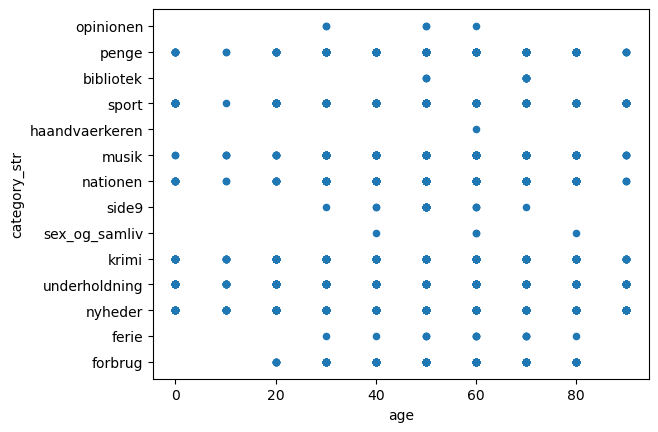

In [23]:
ax = artbeh_df.plot.scatter(x='age',y='category_str')

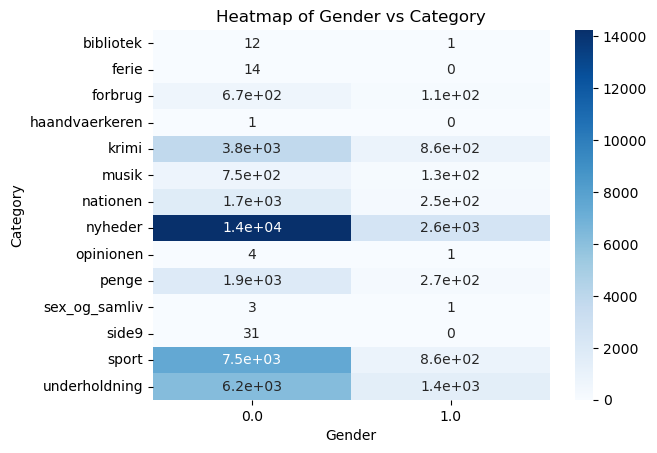

In [24]:
pivot_table = artbeh_df.pivot_table(index='category_str', columns='gender', aggfunc='size', fill_value=0)

sns.heatmap(pivot_table, annot=True, cmap='Blues')
plt.title('Heatmap of Gender vs Category')
plt.xlabel('Gender')
plt.ylabel('Category')
plt.show()


## Cleaning the String Columns

In [25]:
articles_df.head()

,article_id,title,subtitle,last_modified_time,premium,body,published_time,image_ids,article_type,url,...,entity_groups,topics,category,subcategory,category_str,total_inviews,total_pageviews,total_read_time,sentiment_score,sentiment_label
63777,8113223,Bengt Burgs store tv-sorg,Tv-kendissen gav for tre år siden et stort int...,2023-06-29 06:30:08,True,I 12 år var han ankermand på en af de største ...,2023-04-17 10:26:08,"[9723376, 9723405, 9723403, 9723391, 9723369]",article_default,https://ekstrabladet.dk/underholdning/bengt-bu...,...,"[PER, PER, ORG, PER, ORG, ORG, PROD, PER, PER,...","[Kendt, Underholdning, Film og tv]",414,[],underholdning,40638.0,16912.0,1323860.0,0.8872,Negative
83915,9232942,En ægte Dario er gået bort,Latinoen og smørtenoren har sunget og underhol...,2023-06-29 06:41:25,False,"Det er ikke mange mennesker, der skaber et beg...",2023-04-03 13:00:58,"[4626336, 9232886, 9232887, 7567959, 7806334, ...",article_default,https://ekstrabladet.dk/underholdning/dkkendte...,...,"[PROD, PER, LOC, MISC, PER, PER, ORG, PER, ORG...","[Kendt, Livsstil, Underholdning]",414,[425],underholdning,251397.0,29451.0,4352945.0,0.8485,Negative
87490,9321777,- Jeg måtte bare gøre noget,En forening af danske veteraner samler udstyr ...,2023-06-29 06:42:25,True,En camouflagefarvet firehjulstrækker kører ned...,2023-03-26 05:16:43,"[9687457, 9687451, 9687450, 9687454, 9687452, ...",article_default,https://ekstrabladet.dk/krimi/jeg-maatte-bare-...,...,"[LOC, LOC, LOC, ORG, ORG, LOC, ORG, PROD, ORG,...","[Konflikt og krig, Væbnet konflikt]",140,[],krimi,677524.0,27344.0,1994141.0,0.8126,Neutral
96757,9498911,Helmig kronet: Jeg er kongen,Ifølge Thomas Helmig selv regerer han i dansk ...,2023-06-29 06:45:05,False,"Der er vist bred enighed om, at Michael Jackso...",2023-03-25 10:46:30,"[9500351, 9669530, 9498934]",article_default,https://ekstrabladet.dk/musik/dkmusiknyt/helmi...,...,"[ORG, ORG, ORG, PER, PER, LOC, PER, PER, ORG, ...","[Kendt, Underholdning, Musik og lyd]",498,[500],musik,362566.0,77964.0,5736933.0,0.7359,Positive
99598,9539752,De danske cykelstjerners skattefidus,Stort overblik:,2023-07-26 14:41:32,True,default\nFlere af de danske cykelstjerner er s...,2023-04-08 07:50:20,"[9539969, 9703138, 9704157, 9539969, 9704164, ...",article_standard_feature,https://ekstrabladet.dk/sport/cykling/de-dansk...,...,"[LOC, PER, PROD, LOC, PER, LOC, MISC, MISC, PE...","[Sport, Cykling]",142,[317],sport,825594.0,34314.0,1812518.0,0.8997,Neutral


In [26]:
# Dropping the specified columns
columns_to_drop = ['title', 'subtitle', 'body', 'entity_groups', 'url', 'category_str', 'article_type']
articles_DF = articles_df.drop(columns=columns_to_drop)

# Converting 'premium' and 'sentiment_label' to numerical categories
# Assuming 'premium' is True/False and 'sentiment_label' is categorical
articles_DF['premium'] = articles_DF['premium'].astype(int)  # True -> 1, False -> 0
articles_DF['sentiment_label'] = articles_DF['sentiment_label'].astype('category').cat.codes

articles_DF

,article_id,last_modified_time,premium,published_time,image_ids,ner_clusters,topics,category,subcategory,total_inviews,total_pageviews,total_read_time,sentiment_score,sentiment_label
63777,8113223,2023-06-29 06:30:08,1,2023-04-17 10:26:08,"[9723376, 9723405, 9723403, 9723391, 9723369]","[Bente Askjær Dirch Passsers, Carina Jensen, D...","[Kendt, Underholdning, Film og tv]",414,[],40638.0,16912.0,1323860.0,0.8872,0
83915,9232942,2023-06-29 06:41:25,0,2023-04-03 13:00:58,"[4626336, 9232886, 9232887, 7567959, 7806334, ...","[Angelique, Claudia, Danmark, Dario, Darios, E...","[Kendt, Livsstil, Underholdning]",414,[425],251397.0,29451.0,4352945.0,0.8485,0
87490,9321777,2023-06-29 06:42:25,1,2023-03-26 05:16:43,"[9687457, 9687451, 9687450, 9687454, 9687452, ...","[Afghanistan, Caminoen, Danmark, DR, Ekstra Bl...","[Konflikt og krig, Væbnet konflikt]",140,[],677524.0,27344.0,1994141.0,0.8126,1
96757,9498911,2023-06-29 06:45:05,0,2023-03-25 10:46:30,"[9500351, 9669530, 9498934]","[Beatbox Booking, EB, Ekstra Bladet, Johnny Ha...","[Kendt, Underholdning, Musik og lyd]",498,[500],362566.0,77964.0,5736933.0,0.7359,2
99598,9539752,2023-07-26 14:41:32,1,2023-04-08 07:50:20,"[9539969, 9703138, 9704157, 9539969, 9704164, ...","[Andorra, Andreas Kron, Armstrong, Catalonien,...","[Sport, Cykling]",142,[317],825594.0,34314.0,1812518.0,0.8997,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
125535,9803492,2023-06-29 06:49:26,0,2023-06-08 05:49:20,"[9803493, 9803494, 9803495, 9803495, 9803494]","[Hawaiis, Kilauea, Kilauea, Reuters, US Geolog...","[Katastrofe, Vejr, Større katastrofe]",118,[133],535989.0,100120.0,4112624.0,0.6095,1
125536,9803505,2023-06-29 06:49:26,0,2023-06-08 05:54:06,[9803516],"[Alexandra Bøje, All England, Amalie Magelund,...","[Kendt, Begivenhed, Sport, Ketcher- og batspor...",142,"[327, 330]",13320.0,959.0,55691.0,0.8884,2
125537,9803510,2023-06-29 06:49:26,0,2023-06-08 05:48:51,[9803509],"[Bytoften, Erhvervsstyrelsen, Kerteminde Kommu...","[Erhverv, Privat virksomhed, Økonomi]",2889,"[2890, 2900]",12.0,1.0,25.0,0.8723,0
125538,9803525,2023-06-29 06:49:26,0,2023-06-08 06:45:46,"[9803518, 9803519, 9803520, 9803521, 9803522, ...","[Cooper, Englemageren, Julie R, Julie R. Ølgaa...","[Kendt, Livsstil, Familieliv, Underholdning, F...",414,[425],315391.0,50361.0,2550671.0,0.7737,0


In [27]:
behaviors_df.head()

,impression_id,article_id,impression_time,read_time,scroll_percentage,device_type,article_ids_inview,article_ids_clicked,user_id,is_sso_user,gender,postcode,age,is_subscriber,session_id,next_read_time,next_scroll_percentage
23070,1265419,9776420.0,2023-05-23 12:30:42,122.0,100.0,2,"[9777374, 9777648, 9777693, 9777319, 9777190, ...",[9776710],481542,True,0.0,0.0,40.0,True,5005297,17.0,14.0
23101,1265650,9777190.0,2023-05-23 12:06:25,119.0,100.0,1,"[9773574, 9759955, 9775908, 9777299, 9777319, ...",[9777026],489878,True,0.0,3.0,50.0,True,5011577,52.0,100.0
23102,1265651,9777319.0,2023-05-23 12:05:23,54.0,100.0,1,"[9777345, 9695287, 9761920, 9777190, 9777374, ...",[9777374],489878,True,0.0,3.0,50.0,True,5011577,7.0,100.0
23103,1265654,9777026.0,2023-05-23 12:08:25,52.0,100.0,1,"[9777385, 9777026, 9363981, 9777308, 9777393, ...",[9777358],489878,True,0.0,3.0,50.0,True,5011577,68.0,100.0
23142,1265991,9777319.0,2023-05-23 12:03:13,19.0,100.0,1,"[9777320, 9777374, 9777007, 9770051, 9769387, ...",[9777374],502978,True,0.0,3.0,70.0,False,5023105,16.0,100.0


In [28]:
behaviors_df['is_sso_user'] = behaviors_df['is_sso_user'].astype(int)  # True -> 1, False -> 0
behaviors_df['is_subscriber'] = behaviors_df['is_subscriber'].astype(int)  # True -> 1, False -> 0

behavior_DF = behaviors_df

In [29]:
behavior_DF.columns

Index(['impression_id', 'article_id', 'impression_time', 'read_time',
       'scroll_percentage', 'device_type', 'article_ids_inview',
       'article_ids_clicked', 'user_id', 'is_sso_user', 'gender', 'postcode',
       'age', 'is_subscriber', 'session_id', 'next_read_time',
       'next_scroll_percentage'],
      dtype='object')

In [30]:
history_df.head()

,user_id,impression_time_fixed,scroll_percentage_fixed,article_id_fixed,read_time_fixed
0,10029,"[2023-04-28T06:16:57.000000, 2023-04-28T06:17:...","[23.0, 69.0, 27.0, nan, 47.0, 38.0, 100.0, 12....","[9735579, 9739888, 9739471, 9739864, 9738441, ...","[28.0, 24.0, 11.0, 107.0, 8.0, 7.0, 20.0, 5.0,..."
1,10033,"[2023-04-27T11:11:32.000000, 2023-04-27T11:12:...","[33.0, 41.0, 33.0, 100.0, 68.0, 38.0, 1.0, 58....","[9738139, 9738263, 9738139, 9738760, 9738777, ...","[2.0, 2.0, 718.0, 18.0, 26.0, 78.0, 3.0, 11.0,..."
2,10034,"[2023-04-30T09:46:57.000000, 2023-04-30T09:47:...","[nan, 88.0, 27.0, nan, 23.0, 100.0, 100.0, 22....","[9742693, 9742686, 9744016, 9743818, 9744922, ...","[21.0, 103.0, 28.0, 0.0, 5.0, 34.0, 14.0, 14.0..."
3,10041,"[2023-04-27T15:15:28.000000, 2023-04-27T15:16:...","[78.0, 41.0, 4.0, 16.0, 22.0, 32.0, 11.0, 94.0...","[9739035, 9738303, 9737243, 9739634, 9739802, ...","[12.0, 11.0, 3.0, 3.0, 4.0, 13.0, 29.0, 24.0, ..."
4,10103,"[2023-04-27T15:37:35.000000, 2023-04-27T15:38:...","[100.0, nan, 100.0, 100.0, 100.0, 28.0, 82.0, ...","[9739035, 9739164, 9741803, 9740087, 9741986, ...","[45.0, 8.0, 61.0, 72.0, 56.0, 3.0, 22.0, 16.0,..."


In [30]:

history_df.shape

(788090, 5)

In [31]:
# Convert the 'impression_time_fixed' to datetime if it's not already
history_df['impression_time_fixed'] = history_df['impression_time_fixed'].apply(pd.to_datetime)


In [32]:
history_df

,user_id,impression_time_fixed,scroll_percentage_fixed,article_id_fixed,read_time_fixed
0,10029,"DatetimeIndex(['2023-04-28 06:16:57', '2023-04...","[23.0, 69.0, 27.0, nan, 47.0, 38.0, 100.0, 12....","[9735579, 9739888, 9739471, 9739864, 9738441, ...","[28.0, 24.0, 11.0, 107.0, 8.0, 7.0, 20.0, 5.0,..."
1,10033,"DatetimeIndex(['2023-04-27 11:11:32', '2023-04...","[33.0, 41.0, 33.0, 100.0, 68.0, 38.0, 1.0, 58....","[9738139, 9738263, 9738139, 9738760, 9738777, ...","[2.0, 2.0, 718.0, 18.0, 26.0, 78.0, 3.0, 11.0,..."
2,10034,"DatetimeIndex(['2023-04-30 09:46:57', '2023-04...","[nan, 88.0, 27.0, nan, 23.0, 100.0, 100.0, 22....","[9742693, 9742686, 9744016, 9743818, 9744922, ...","[21.0, 103.0, 28.0, 0.0, 5.0, 34.0, 14.0, 14.0..."
3,10041,"DatetimeIndex(['2023-04-27 15:15:28', '2023-04...","[78.0, 41.0, 4.0, 16.0, 22.0, 32.0, 11.0, 94.0...","[9739035, 9738303, 9737243, 9739634, 9739802, ...","[12.0, 11.0, 3.0, 3.0, 4.0, 13.0, 29.0, 24.0, ..."
4,10103,"DatetimeIndex(['2023-04-27 15:37:35', '2023-04...","[100.0, nan, 100.0, 100.0, 100.0, 28.0, 82.0, ...","[9739035, 9739164, 9741803, 9740087, 9741986, ...","[45.0, 8.0, 61.0, 72.0, 56.0, 3.0, 22.0, 16.0,..."
...,...,...,...,...,...
788085,1802030,"DatetimeIndex(['2023-05-13 16:20:53', '2023-05...","[50.0, 28.0, 13.0, 29.0, 28.0, 66.0]","[9763579, 9763448, 9763398, 9763401, 9761588, ...","[18.0, 11.0, 17.0, 25.0, 13.0, 1.0]"
788086,2146107,"DatetimeIndex(['2023-05-10 21:44:01', '2023-05...","[100.0, 56.0, 100.0, 100.0, 100.0]","[9758717, 9758538, 9758717, 9758074, 9758717]","[119.0, 3.0, 5.0, 33.0, 0.0]"
788087,1200613,"DatetimeIndex(['2023-04-30 05:24:43', '2023-04...","[70.0, 45.0, 67.0, 40.0, 51.0, 72.0, 50.0, 53....","[9742619, 9742627, 9742586, 9742625, 9741144, ...","[14.0, 17.0, 23.0, 50.0, 33.0, 39.0, 16.0, 329..."
788088,1375724,"DatetimeIndex(['2023-05-10 12:25:50', '2023-05...","[91.0, 100.0, 71.0, 64.0, 61.0, 41.0, 49.0, 74...","[9757876, 9757857, 9757676, 9757639, 9757746, ...","[11.0, 5.0, 4.0, 20.0, 2.0, 6.0, 2.0, 1.0, 3.0..."


In [33]:
# Loop through the first two rows and check the chronological order of the times in each list
def is_chronological(time_list):
    # Check if the list of times is in chronological order
    return all(time_list[i] < time_list[i+1] for i in range(len(time_list) - 1))

# Check chronological order for the first two rows
first_two_rows_chronological = [
    is_chronological(history_df['impression_time_fixed'][i]) for i in range(2)
]

# Print results
for i, is_chrono in enumerate(first_two_rows_chronological):
    print(f"Row {i+1} chronological: {is_chrono}")

Row 1 chronological: True
Row 2 chronological: True


That means the click time is chronological. Do we want to mark next read only if it's within the next day?

In [168]:
behavior_DF.shape

(49662, 17)

In [169]:
articles_DF.shape

(14426, 14)

In [170]:
behaviors_df

,impression_id,article_id,impression_time,read_time,scroll_percentage,device_type,article_ids_inview,article_ids_clicked,user_id,is_sso_user,gender,postcode,age,is_subscriber,session_id,next_read_time,next_scroll_percentage
23070,1265419,9776420.0,2023-05-23 12:30:42,122.0,100.0,2,"[9777374, 9777648, 9777693, 9777319, 9777190, ...",[9776710],481542,1,0.0,0.0,40.0,1,5005297,17.0,14.0
23101,1265650,9777190.0,2023-05-23 12:06:25,119.0,100.0,1,"[9773574, 9759955, 9775908, 9777299, 9777319, ...",[9777026],489878,1,0.0,3.0,50.0,1,5011577,52.0,100.0
23102,1265651,9777319.0,2023-05-23 12:05:23,54.0,100.0,1,"[9777345, 9695287, 9761920, 9777190, 9777374, ...",[9777374],489878,1,0.0,3.0,50.0,1,5011577,7.0,100.0
23103,1265654,9777026.0,2023-05-23 12:08:25,52.0,100.0,1,"[9777385, 9777026, 9363981, 9777308, 9777393, ...",[9777358],489878,1,0.0,3.0,50.0,1,5011577,68.0,100.0
23142,1265991,9777319.0,2023-05-23 12:03:13,19.0,100.0,1,"[9777320, 9777374, 9777007, 9770051, 9769387, ...",[9777374],502978,1,0.0,3.0,70.0,0,5023105,16.0,100.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12031599,578903093,9775484.0,2023-05-22 03:39:41,607.0,100.0,1,"[9775500, 9661024, 9672569, 9775277, 9766752]",[9672569],413959,1,0.0,0.0,50.0,1,88117134,662.0,56.0
12031610,578903280,9775484.0,2023-05-22 03:46:51,25.0,100.0,1,"[9768866, 9775347, 9775484, 9775485, 9754160, ...",[9754160],418966,1,0.0,0.0,70.0,1,5596745,9.0,6.0
12031622,578903358,9775484.0,2023-05-22 03:09:56,978.0,100.0,2,"[9775489, 8315213, 9775493, 9775485, 9770028, ...",[9775402],420945,1,0.0,1.0,40.0,1,16620596,114.0,100.0
12031645,578903597,9775484.0,2023-05-22 03:33:50,432.0,100.0,1,"[9775419, 9775402, 9775489, 9775361, 9754160, ...",[9772706],440519,1,0.0,4.0,50.0,0,96961920,229.0,100.0


In [32]:
from sklearn.model_selection import train_test_split

# Split `behavior_DF` into training and validation sets
behavior_train, behavior_val = train_test_split(
    behavior_DF,
    test_size=0.2,  # 20% for validation
    random_state=42,  # For reproducibility
)

# Get user_ids for validation set
val_user_ids = set(behavior_val['user_id'])

# Filter `history_df` to match the validation user_ids
history_val = history_df[history_df['user_id'].isin(val_user_ids)]
history_train = history_df[~history_df['user_id'].isin(val_user_ids)]

# Display resulting shapes
print("Behavior Train:", behavior_train.shape)
print("Behavior Validation:", behavior_val.shape)
print("History Train:", history_train.shape)
print("History Validation:", history_val.shape)

Behavior Train: (39729, 17)
Behavior Validation: (9933, 17)
History Train: (785067, 5)
History Validation: (3023, 5)


In [172]:
articles_DF

,article_id,last_modified_time,premium,published_time,image_ids,ner_clusters,topics,category,subcategory,total_inviews,total_pageviews,total_read_time,sentiment_score,sentiment_label
63777,8113223,2023-06-29 06:30:08,1,2023-04-17 10:26:08,"[9723376, 9723405, 9723403, 9723391, 9723369]","[Bente Askjær Dirch Passsers, Carina Jensen, D...","[Kendt, Underholdning, Film og tv]",414,[],40638.0,16912.0,1323860.0,0.8872,0
83915,9232942,2023-06-29 06:41:25,0,2023-04-03 13:00:58,"[4626336, 9232886, 9232887, 7567959, 7806334, ...","[Angelique, Claudia, Danmark, Dario, Darios, E...","[Kendt, Livsstil, Underholdning]",414,[425],251397.0,29451.0,4352945.0,0.8485,0
87490,9321777,2023-06-29 06:42:25,1,2023-03-26 05:16:43,"[9687457, 9687451, 9687450, 9687454, 9687452, ...","[Afghanistan, Caminoen, Danmark, DR, Ekstra Bl...","[Konflikt og krig, Væbnet konflikt]",140,[],677524.0,27344.0,1994141.0,0.8126,1
96757,9498911,2023-06-29 06:45:05,0,2023-03-25 10:46:30,"[9500351, 9669530, 9498934]","[Beatbox Booking, EB, Ekstra Bladet, Johnny Ha...","[Kendt, Underholdning, Musik og lyd]",498,[500],362566.0,77964.0,5736933.0,0.7359,2
99598,9539752,2023-07-26 14:41:32,1,2023-04-08 07:50:20,"[9539969, 9703138, 9704157, 9539969, 9704164, ...","[Andorra, Andreas Kron, Armstrong, Catalonien,...","[Sport, Cykling]",142,[317],825594.0,34314.0,1812518.0,0.8997,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
125535,9803492,2023-06-29 06:49:26,0,2023-06-08 05:49:20,"[9803493, 9803494, 9803495, 9803495, 9803494]","[Hawaiis, Kilauea, Kilauea, Reuters, US Geolog...","[Katastrofe, Vejr, Større katastrofe]",118,[133],535989.0,100120.0,4112624.0,0.6095,1
125536,9803505,2023-06-29 06:49:26,0,2023-06-08 05:54:06,[9803516],"[Alexandra Bøje, All England, Amalie Magelund,...","[Kendt, Begivenhed, Sport, Ketcher- og batspor...",142,"[327, 330]",13320.0,959.0,55691.0,0.8884,2
125537,9803510,2023-06-29 06:49:26,0,2023-06-08 05:48:51,[9803509],"[Bytoften, Erhvervsstyrelsen, Kerteminde Kommu...","[Erhverv, Privat virksomhed, Økonomi]",2889,"[2890, 2900]",12.0,1.0,25.0,0.8723,0
125538,9803525,2023-06-29 06:49:26,0,2023-06-08 06:45:46,"[9803518, 9803519, 9803520, 9803521, 9803522, ...","[Cooper, Englemageren, Julie R, Julie R. Ølgaa...","[Kendt, Livsstil, Familieliv, Underholdning, F...",414,[425],315391.0,50361.0,2550671.0,0.7737,0


In [ ]:
# Create 5 quantile bins
articles_DF['total_inviews'] = pd.qcut(articles_DF['total_inviews'], q=5, labels=[1, 2, 3, 4, 5])



In [174]:
articles_DF

,article_id,last_modified_time,premium,published_time,image_ids,ner_clusters,topics,category,subcategory,total_inviews,total_pageviews,total_read_time,sentiment_score,sentiment_label
63777,8113223,2023-06-29 06:30:08,1,2023-04-17 10:26:08,"[9723376, 9723405, 9723403, 9723391, 9723369]","[Bente Askjær Dirch Passsers, Carina Jensen, D...","[Kendt, Underholdning, Film og tv]",414,[],2,16912.0,1323860.0,0.8872,0
83915,9232942,2023-06-29 06:41:25,0,2023-04-03 13:00:58,"[4626336, 9232886, 9232887, 7567959, 7806334, ...","[Angelique, Claudia, Danmark, Dario, Darios, E...","[Kendt, Livsstil, Underholdning]",414,[425],2,29451.0,4352945.0,0.8485,0
87490,9321777,2023-06-29 06:42:25,1,2023-03-26 05:16:43,"[9687457, 9687451, 9687450, 9687454, 9687452, ...","[Afghanistan, Caminoen, Danmark, DR, Ekstra Bl...","[Konflikt og krig, Væbnet konflikt]",140,[],5,27344.0,1994141.0,0.8126,1
96757,9498911,2023-06-29 06:45:05,0,2023-03-25 10:46:30,"[9500351, 9669530, 9498934]","[Beatbox Booking, EB, Ekstra Bladet, Johnny Ha...","[Kendt, Underholdning, Musik og lyd]",498,[500],3,77964.0,5736933.0,0.7359,2
99598,9539752,2023-07-26 14:41:32,1,2023-04-08 07:50:20,"[9539969, 9703138, 9704157, 9539969, 9704164, ...","[Andorra, Andreas Kron, Armstrong, Catalonien,...","[Sport, Cykling]",142,[317],5,34314.0,1812518.0,0.8997,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
125535,9803492,2023-06-29 06:49:26,0,2023-06-08 05:49:20,"[9803493, 9803494, 9803495, 9803495, 9803494]","[Hawaiis, Kilauea, Kilauea, Reuters, US Geolog...","[Katastrofe, Vejr, Større katastrofe]",118,[133],5,100120.0,4112624.0,0.6095,1
125536,9803505,2023-06-29 06:49:26,0,2023-06-08 05:54:06,[9803516],"[Alexandra Bøje, All England, Amalie Magelund,...","[Kendt, Begivenhed, Sport, Ketcher- og batspor...",142,"[327, 330]",2,959.0,55691.0,0.8884,2
125537,9803510,2023-06-29 06:49:26,0,2023-06-08 05:48:51,[9803509],"[Bytoften, Erhvervsstyrelsen, Kerteminde Kommu...","[Erhverv, Privat virksomhed, Økonomi]",2889,"[2890, 2900]",1,1.0,25.0,0.8723,0
125538,9803525,2023-06-29 06:49:26,0,2023-06-08 06:45:46,"[9803518, 9803519, 9803520, 9803521, 9803522, ...","[Cooper, Englemageren, Julie R, Julie R. Ølgaa...","[Kendt, Livsstil, Familieliv, Underholdning, F...",414,[425],3,50361.0,2550671.0,0.7737,0


In [175]:
# Create 5 quantile bins
articles_DF['total_pageviews'] = pd.qcut(articles_DF['total_pageviews'], q=5, labels=[1, 2, 3, 4, 5])
articles_DF['total_read_time'] = pd.qcut(articles_DF['total_read_time'], q=5, labels=[1, 2, 3, 4, 5])

In [176]:
articles_DF

,article_id,last_modified_time,premium,published_time,image_ids,ner_clusters,topics,category,subcategory,total_inviews,total_pageviews,total_read_time,sentiment_score,sentiment_label
63777,8113223,2023-06-29 06:30:08,1,2023-04-17 10:26:08,"[9723376, 9723405, 9723403, 9723391, 9723369]","[Bente Askjær Dirch Passsers, Carina Jensen, D...","[Kendt, Underholdning, Film og tv]",414,[],2,2,2,0.8872,0
83915,9232942,2023-06-29 06:41:25,0,2023-04-03 13:00:58,"[4626336, 9232886, 9232887, 7567959, 7806334, ...","[Angelique, Claudia, Danmark, Dario, Darios, E...","[Kendt, Livsstil, Underholdning]",414,[425],2,2,4,0.8485,0
87490,9321777,2023-06-29 06:42:25,1,2023-03-26 05:16:43,"[9687457, 9687451, 9687450, 9687454, 9687452, ...","[Afghanistan, Caminoen, Danmark, DR, Ekstra Bl...","[Konflikt og krig, Væbnet konflikt]",140,[],5,2,3,0.8126,1
96757,9498911,2023-06-29 06:45:05,0,2023-03-25 10:46:30,"[9500351, 9669530, 9498934]","[Beatbox Booking, EB, Ekstra Bladet, Johnny Ha...","[Kendt, Underholdning, Musik og lyd]",498,[500],3,4,5,0.7359,2
99598,9539752,2023-07-26 14:41:32,1,2023-04-08 07:50:20,"[9539969, 9703138, 9704157, 9539969, 9704164, ...","[Andorra, Andreas Kron, Armstrong, Catalonien,...","[Sport, Cykling]",142,[317],5,3,3,0.8997,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
125535,9803492,2023-06-29 06:49:26,0,2023-06-08 05:49:20,"[9803493, 9803494, 9803495, 9803495, 9803494]","[Hawaiis, Kilauea, Kilauea, Reuters, US Geolog...","[Katastrofe, Vejr, Større katastrofe]",118,[133],5,5,4,0.6095,1
125536,9803505,2023-06-29 06:49:26,0,2023-06-08 05:54:06,[9803516],"[Alexandra Bøje, All England, Amalie Magelund,...","[Kendt, Begivenhed, Sport, Ketcher- og batspor...",142,"[327, 330]",2,2,2,0.8884,2
125537,9803510,2023-06-29 06:49:26,0,2023-06-08 05:48:51,[9803509],"[Bytoften, Erhvervsstyrelsen, Kerteminde Kommu...","[Erhverv, Privat virksomhed, Økonomi]",2889,"[2890, 2900]",1,1,1,0.8723,0
125538,9803525,2023-06-29 06:49:26,0,2023-06-08 06:45:46,"[9803518, 9803519, 9803520, 9803521, 9803522, ...","[Cooper, Englemageren, Julie R, Julie R. Ølgaa...","[Kendt, Livsstil, Familieliv, Underholdning, F...",414,[425],3,3,3,0.7737,0


In [177]:
articles_DF['combination'] = articles_DF['category'].astype(str) + '-' + \
                     articles_DF['subcategory'].astype(str) + '-' + \
                     articles_DF['total_inviews'].astype(str) + '-' + \
                     articles_DF['total_pageviews'].astype(str) + '-' + \
                     articles_DF['total_read_time'].astype(str) + '-' + \
                     articles_DF['sentiment_label'].astype(str)

In [178]:
articles_DF

,article_id,last_modified_time,premium,published_time,image_ids,ner_clusters,topics,category,subcategory,total_inviews,total_pageviews,total_read_time,sentiment_score,sentiment_label,combination
63777,8113223,2023-06-29 06:30:08,1,2023-04-17 10:26:08,"[9723376, 9723405, 9723403, 9723391, 9723369]","[Bente Askjær Dirch Passsers, Carina Jensen, D...","[Kendt, Underholdning, Film og tv]",414,[],2,2,2,0.8872,0,414-[]-2-2-2-0
83915,9232942,2023-06-29 06:41:25,0,2023-04-03 13:00:58,"[4626336, 9232886, 9232887, 7567959, 7806334, ...","[Angelique, Claudia, Danmark, Dario, Darios, E...","[Kendt, Livsstil, Underholdning]",414,[425],2,2,4,0.8485,0,414-[425]-2-2-4-0
87490,9321777,2023-06-29 06:42:25,1,2023-03-26 05:16:43,"[9687457, 9687451, 9687450, 9687454, 9687452, ...","[Afghanistan, Caminoen, Danmark, DR, Ekstra Bl...","[Konflikt og krig, Væbnet konflikt]",140,[],5,2,3,0.8126,1,140-[]-5-2-3-1
96757,9498911,2023-06-29 06:45:05,0,2023-03-25 10:46:30,"[9500351, 9669530, 9498934]","[Beatbox Booking, EB, Ekstra Bladet, Johnny Ha...","[Kendt, Underholdning, Musik og lyd]",498,[500],3,4,5,0.7359,2,498-[500]-3-4-5-2
99598,9539752,2023-07-26 14:41:32,1,2023-04-08 07:50:20,"[9539969, 9703138, 9704157, 9539969, 9704164, ...","[Andorra, Andreas Kron, Armstrong, Catalonien,...","[Sport, Cykling]",142,[317],5,3,3,0.8997,1,142-[317]-5-3-3-1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
125535,9803492,2023-06-29 06:49:26,0,2023-06-08 05:49:20,"[9803493, 9803494, 9803495, 9803495, 9803494]","[Hawaiis, Kilauea, Kilauea, Reuters, US Geolog...","[Katastrofe, Vejr, Større katastrofe]",118,[133],5,5,4,0.6095,1,118-[133]-5-5-4-1
125536,9803505,2023-06-29 06:49:26,0,2023-06-08 05:54:06,[9803516],"[Alexandra Bøje, All England, Amalie Magelund,...","[Kendt, Begivenhed, Sport, Ketcher- og batspor...",142,"[327, 330]",2,2,2,0.8884,2,142-[327 330]-2-2-2-2
125537,9803510,2023-06-29 06:49:26,0,2023-06-08 05:48:51,[9803509],"[Bytoften, Erhvervsstyrelsen, Kerteminde Kommu...","[Erhverv, Privat virksomhed, Økonomi]",2889,"[2890, 2900]",1,1,1,0.8723,0,2889-[2890 2900]-1-1-1-0
125538,9803525,2023-06-29 06:49:26,0,2023-06-08 06:45:46,"[9803518, 9803519, 9803520, 9803521, 9803522, ...","[Cooper, Englemageren, Julie R, Julie R. Ølgaa...","[Kendt, Livsstil, Familieliv, Underholdning, F...",414,[425],3,3,3,0.7737,0,414-[425]-3-3-3-0


In [179]:
# Convert categorical column to numerical labels
articles_DF['combination'] = pd.Categorical(articles_DF['combination']).codes

In [35]:
from sklearn.metrics.pairwise import cosine_similarity

In [188]:
row_1 = articles_DF.loc[63777, ['total_inviews', 'total_pageviews', "total_read_time", "sentiment_label"]].values.reshape(1, -1)  # Reshape to 2D array
row_2 = articles_DF.loc[83915, ['total_inviews', 'total_pageviews', "total_read_time", "sentiment_label"]].values.reshape(1, -1)  # Reshape to 2D array

In [187]:
articles_DF.loc[63777, ['total_inviews', 'total_pageviews', "total_read_time", "sentiment_label"]]

total_inviews      2
total_pageviews    2
total_read_time    2
sentiment_label    0
Name: 63777, dtype: object

In [189]:
# Compute cosine similarity
similarity = cosine_similarity(row_1, row_2)

print(f'Cosine Similarity between row 0 and row 1: {similarity[0][0]}')

Cosine Similarity between row 0 and row 1: 0.9428090415820636


The cosine similarity ranges from -1 (completely dissimilar) to 1 (completely similar).

In [193]:
articles_DF

,article_id,last_modified_time,premium,published_time,image_ids,ner_clusters,topics,category,subcategory,total_inviews,total_pageviews,total_read_time,sentiment_score,sentiment_label,combination
63777,8113223,2023-06-29 06:30:08,1,2023-04-17 10:26:08,"[9723376, 9723405, 9723403, 9723391, 9723369]","[Bente Askjær Dirch Passsers, Carina Jensen, D...","[Kendt, Underholdning, Film og tv]",414,[],2,2,2,0.8872,0,2811
83915,9232942,2023-06-29 06:41:25,0,2023-04-03 13:00:58,"[4626336, 9232886, 9232887, 7567959, 7806334, ...","[Angelique, Claudia, Danmark, Dario, Darios, E...","[Kendt, Livsstil, Underholdning]",414,[425],2,2,4,0.8485,0,2376
87490,9321777,2023-06-29 06:42:25,1,2023-03-26 05:16:43,"[9687457, 9687451, 9687450, 9687454, 9687452, ...","[Afghanistan, Caminoen, Danmark, DR, Ekstra Bl...","[Konflikt og krig, Væbnet konflikt]",140,[],5,2,3,0.8126,1,607
96757,9498911,2023-06-29 06:45:05,0,2023-03-25 10:46:30,"[9500351, 9669530, 9498934]","[Beatbox Booking, EB, Ekstra Bladet, Johnny Ha...","[Kendt, Underholdning, Musik og lyd]",498,[500],3,4,5,0.7359,2,2994
99598,9539752,2023-07-26 14:41:32,1,2023-04-08 07:50:20,"[9539969, 9703138, 9704157, 9539969, 9704164, ...","[Andorra, Andreas Kron, Armstrong, Catalonien,...","[Sport, Cykling]",142,[317],5,3,3,0.8997,1,1779
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
125535,9803492,2023-06-29 06:49:26,0,2023-06-08 05:49:20,"[9803493, 9803494, 9803495, 9803495, 9803494]","[Hawaiis, Kilauea, Kilauea, Reuters, US Geolog...","[Katastrofe, Vejr, Større katastrofe]",118,[133],5,5,4,0.6095,1,436
125536,9803505,2023-06-29 06:49:26,0,2023-06-08 05:54:06,[9803516],"[Alexandra Bøje, All England, Amalie Magelund,...","[Kendt, Begivenhed, Sport, Ketcher- og batspor...",142,"[327, 330]",2,2,2,0.8884,2,1840
125537,9803510,2023-06-29 06:49:26,0,2023-06-08 05:48:51,[9803509],"[Bytoften, Erhvervsstyrelsen, Kerteminde Kommu...","[Erhverv, Privat virksomhed, Økonomi]",2889,"[2890, 2900]",1,1,1,0.8723,0,2289
125538,9803525,2023-06-29 06:49:26,0,2023-06-08 06:45:46,"[9803518, 9803519, 9803520, 9803521, 9803522, ...","[Cooper, Englemageren, Julie R, Julie R. Ølgaa...","[Kendt, Livsstil, Familieliv, Underholdning, F...",414,[425],3,3,3,0.7737,0,2393


In [36]:
# Set the first column ('ID') as the index
articles_DF.set_index('article_id', inplace=True)

NameError: name 'articles_DF' is not defined

In [199]:
articles_DF

,last_modified_time,premium,published_time,image_ids,ner_clusters,topics,category,subcategory,total_inviews,total_pageviews,total_read_time,sentiment_score,sentiment_label,combination
article_id,,,,,,,,,,,,,,
8113223,2023-06-29 06:30:08,1,2023-04-17 10:26:08,"[9723376, 9723405, 9723403, 9723391, 9723369]","[Bente Askjær Dirch Passsers, Carina Jensen, D...","[Kendt, Underholdning, Film og tv]",414,[],2,2,2,0.8872,0,2811
9232942,2023-06-29 06:41:25,0,2023-04-03 13:00:58,"[4626336, 9232886, 9232887, 7567959, 7806334, ...","[Angelique, Claudia, Danmark, Dario, Darios, E...","[Kendt, Livsstil, Underholdning]",414,[425],2,2,4,0.8485,0,2376
9321777,2023-06-29 06:42:25,1,2023-03-26 05:16:43,"[9687457, 9687451, 9687450, 9687454, 9687452, ...","[Afghanistan, Caminoen, Danmark, DR, Ekstra Bl...","[Konflikt og krig, Væbnet konflikt]",140,[],5,2,3,0.8126,1,607
9498911,2023-06-29 06:45:05,0,2023-03-25 10:46:30,"[9500351, 9669530, 9498934]","[Beatbox Booking, EB, Ekstra Bladet, Johnny Ha...","[Kendt, Underholdning, Musik og lyd]",498,[500],3,4,5,0.7359,2,2994
9539752,2023-07-26 14:41:32,1,2023-04-08 07:50:20,"[9539969, 9703138, 9704157, 9539969, 9704164, ...","[Andorra, Andreas Kron, Armstrong, Catalonien,...","[Sport, Cykling]",142,[317],5,3,3,0.8997,1,1779
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9803492,2023-06-29 06:49:26,0,2023-06-08 05:49:20,"[9803493, 9803494, 9803495, 9803495, 9803494]","[Hawaiis, Kilauea, Kilauea, Reuters, US Geolog...","[Katastrofe, Vejr, Større katastrofe]",118,[133],5,5,4,0.6095,1,436
9803505,2023-06-29 06:49:26,0,2023-06-08 05:54:06,[9803516],"[Alexandra Bøje, All England, Amalie Magelund,...","[Kendt, Begivenhed, Sport, Ketcher- og batspor...",142,"[327, 330]",2,2,2,0.8884,2,1840
9803510,2023-06-29 06:49:26,0,2023-06-08 05:48:51,[9803509],"[Bytoften, Erhvervsstyrelsen, Kerteminde Kommu...","[Erhverv, Privat virksomhed, Økonomi]",2889,"[2890, 2900]",1,1,1,0.8723,0,2289


In [222]:
selected_columns = ['category','Total_Inviews', 'Total_Pageviews', 'Total_Read_Time']

tmp = 0
total_sim = list()

for idx, row in history_train[:20].iterrows():
    tmp_list = list()
    for a_id in list(set(row["article_id_fixed"])):
        articles_id_List = list(set(row["article_id_fixed"]))
        if tmp < len(articles_id_List):
            if articles_id_List[tmp] in articles_DF.index and articles_id_List[tmp+1] in articles_DF.index:

                row_1 = articles_DF.loc[articles_id_List[tmp], ['total_inviews', 'total_pageviews', "total_read_time", "sentiment_label"]].values.reshape(1, -1)  # Reshape to 2D array
                row_2 = articles_DF.loc[articles_id_List[tmp+1], ['total_inviews', 'total_pageviews', "total_read_time", "sentiment_label"]].values.reshape(1, -1)  # Reshape to 2D array
                print(row_1,row_2)
                
                similarity = cosine_similarity(row_1, row_2)
                #print(f'Cosine Similarity between row 0 and row 1: {similarity[0][0]}')
                tmp_list.append(similarity[0][0])

                print(tmp_list)

                tmp +=1
    print(np.mean(tmp_list))
    total_sim.append(np.mean(tmp_list))


[[5 5 5 0]] [[4 4 4 0]]
[1.0]
[[4 4 4 0]] [[5 2 2 0]]
[1.0, 0.904534033733291]
[[5 2 2 0]] [[4 4 5 1]]
[1.0, 0.904534033733291, 0.8685856096767393]
[[4 4 5 1]] [[3 4 4 0]]
[1.0, 0.904534033733291, 0.8685856096767393, 0.9843177398340743]
0.9393593458110262
[[2 3 2 0]] [[3 3 4 2]]
[0.9049228966693288]
[[3 3 4 2]] [[2 2 2 0]]
[0.9049228966693288, 0.9365858115816941]
[[2 2 2 0]] [[3 4 5 1]]
[0.9049228966693288, 0.9365858115816941, 0.9701425001453319]
[[3 4 5 1]] [[5 5 5 2]]
[0.9049228966693288, 0.9365858115816941, 0.9701425001453319, 0.9767716718775057]
[[5 5 5 2]] [[4 5 4 0]]
[0.9049228966693288, 0.9365858115816941, 0.9701425001453319, 0.9767716718775057, 0.9686399640572909]
[[4 5 4 0]] [[2 3 2 1]]
[0.9049228966693288, 0.9365858115816941, 0.9701425001453319, 0.9767716718775057, 0.9686399640572909, 0.9678053386344172]
[[2 3 2 1]] [[5 5 5 0]]
[0.9049228966693288, 0.9365858115816941, 0.9701425001453319, 0.9767716718775057, 0.9686399640572909, 0.9678053386344172, 0.9525793444156804]
[[5 5 5 0

c:\Users\bilba\anaconda3\Lib\site-packages\numpy\core\fromnumeric.py:3504: RuntimeWarning:

Mean of empty slice.

c:\Users\bilba\anaconda3\Lib\site-packages\numpy\core\_methods.py:129: RuntimeWarning:

invalid value encountered in scalar divide

c:\Users\bilba\anaconda3\Lib\site-packages\numpy\core\fromnumeric.py:3504: RuntimeWarning:

Mean of empty slice.

c:\Users\bilba\anaconda3\Lib\site-packages\numpy\core\_methods.py:129: RuntimeWarning:

invalid value encountered in scalar divide

c:\Users\bilba\anaconda3\Lib\site-packages\numpy\core\fromnumeric.py:3504: RuntimeWarning:

Mean of empty slice.

c:\Users\bilba\anaconda3\Lib\site-packages\numpy\core\_methods.py:129: RuntimeWarning:

invalid value encountered in scalar divide



In [229]:
"""""

import numpy as np
from sklearn.metrics.pairwise import cosine_similarity

# Selected columns to compare
selected_columns = ['total_inviews', 'total_pageviews', 'total_read_time', 'sentiment_label']

# Iterate over the first 20 rows in `history_train`
total_sim = []
for idx, row in history_train.iterrows():
    tmp_list = []
    # Loop through each article ID in the row's article_id list
    articles_id_List = list(set(row["article_id_fixed"]))  # Ensure unique article IDs

    # Compare each article with the next one
    for tmp in range(len(articles_id_List) - 1):
        # Get the current and next article IDs
        current_id = articles_id_List[tmp]
        next_id = articles_id_List[tmp + 1]

        # Check if both articles exist in `articles_DF`
        if current_id in articles_DF.index and next_id in articles_DF.index:
            # Select data from `articles_DF` for the current and next article
            row_1 = articles_DF.loc[current_id, selected_columns].values.reshape(1, -1)
            row_2 = articles_DF.loc[next_id, selected_columns].values.reshape(1, -1)

            # Compute cosine similarity, handling NaN values
            similarity = cosine_similarity(row_1, row_2)
            tmp_list.append(similarity[0][0])

    # Compute the average similarity for this row
    if tmp_list:  # Check if the list is not empty
        mean_similarity = np.mean(tmp_list)
    else:
        mean_similarity = 0  # If no valid data to compare, set similarity to 0

    total_sim.append(mean_similarity)

# `total_sim` now contains the average similarity for each user-article interaction pair in `history_train[:20]`


SyntaxError: incomplete input (3702377005.py, line 1)

^Above code will run for x amount of time.

In [ ]:
import numpy as np
from sklearn.metrics.pairwise import cosine_similarity

# Selected columns to compare
selected_columns = ['total_inviews', 'total_pageviews', 'total_read_time', 'sentiment_label']


tmp2 = len(list(history_train["article_id_fixed"]))
# Iterate over the first 20 rows in `history_train`
total_sim = []
for row in list(history_train["article_id_fixed"]):
    tmp_list = []
    #print(row)
    # Loop through each article ID in the row's article_id list
    articles_id_List = row  # Ensure unique article IDs

    # Compare each article with the next one
    for tmp in range(len(articles_id_List) - 1):
        # Get the current and next article IDs
        current_id = articles_id_List[tmp]
        next_id = articles_id_List[tmp + 1]

        # Check if both articles exist in `articles_DF`
        if current_id in articles_DF.index and next_id in articles_DF.index:
            # Select data from `articles_DF` for the current and next article
            row_1 = articles_DF.loc[current_id, selected_columns].values.reshape(1, -1)
            row_2 = articles_DF.loc[next_id, selected_columns].values.reshape(1, -1)

            # Compute cosine similarity, handling NaN values
            similarity = cosine_similarity(row_1, row_2)
            tmp_list.append(similarity[0][0])

    # Compute the average similarity for this row
    if tmp_list:  # Check if the list is not empty
        mean_similarity = np.mean(tmp_list)
    else:
        mean_similarity = 0  # If no valid data to compare, set similarity to 0

    total_sim.append(mean_similarity)
    print(len(total_sim), "/", tmp2)

# `total_sim` now contains the average similarity for each user-article interaction pair in `history_train[:20]`


1 / 785067
2 / 785067
3 / 785067
4 / 785067
5 / 785067
6 / 785067
7 / 785067
8 / 785067
9 / 785067
10 / 785067
11 / 785067
12 / 785067
13 / 785067
14 / 785067
15 / 785067
16 / 785067
17 / 785067
18 / 785067
19 / 785067
20 / 785067
21 / 785067
22 / 785067
23 / 785067
24 / 785067
25 / 785067
26 / 785067
27 / 785067
28 / 785067
29 / 785067
30 / 785067
31 / 785067
32 / 785067
33 / 785067
34 / 785067
35 / 785067
36 / 785067
37 / 785067
38 / 785067
39 / 785067
40 / 785067
41 / 785067
42 / 785067
43 / 785067
44 / 785067
45 / 785067
46 / 785067
47 / 785067
48 / 785067
49 / 785067
50 / 785067
51 / 785067
52 / 785067
53 / 785067
54 / 785067
55 / 785067
56 / 785067
57 / 785067
58 / 785067
59 / 785067
60 / 785067
61 / 785067
62 / 785067
63 / 785067
64 / 785067
65 / 785067
66 / 785067
67 / 785067
68 / 785067
69 / 785067
70 / 785067
71 / 785067
72 / 785067
73 / 785067
74 / 785067
75 / 785067
76 / 785067
77 / 785067
78 / 785067
79 / 785067
80 / 785067
81 / 785067
82 / 785067
83 / 785067
84 / 785067
8

KeyboardInterrupt: 

In [240]:
import numpy as np
from sklearn.metrics.pairwise import cosine_similarity
from joblib import Parallel, delayed

# Selected columns to compare
selected_columns = ['total_inviews', 'total_pageviews', 'total_read_time', 'sentiment_label']

# Pre-calculate article data
articles_array = articles_DF[selected_columns].to_numpy()
article_id_to_index = {id_: idx for idx, id_ in enumerate(articles_DF.index)}

def calculate_similarity_for_row(row, articles_array, article_id_to_index):
    tmp_list = []
    for tmp in range(len(row) - 1):
        current_id = row[tmp]
        next_id = row[tmp + 1]

        if current_id in article_id_to_index and next_id in article_id_to_index:
            row_1 = articles_array[article_id_to_index[current_id]]
            row_2 = articles_array[article_id_to_index[next_id]]

            similarity = cosine_similarity([row_1], [row_2])[0][0]
            tmp_list.append(similarity)
    return np.mean(tmp_list) if tmp_list else 0

# Parallelize over rows in `history_train`
total_sim = Parallel(n_jobs=-1)(
    delayed(calculate_similarity_for_row)(row, articles_array, article_id_to_index)
    for row in history_train["article_id_fixed"][:20]
)

print(total_sim)


[0.9781443216656328, 0.9810953970268707, 0.9784435093368802, 0.9836610471434305, 0.970851813905766, 0.9745196035236922, 0.9775908478358304, 0.9782662778406468, 0.9815397656213198, 0.9781604090139893, 0.9891006991387021, 0.9819076253906964, 0.9793806464016925, 0.984076154880712, 0.97296662180258, 0.9800666818164808, 0.9742609939196076, 0.9818082795138355, 0.9799114425789683, 0.9789090065166602]


In [242]:
import numpy as np
from sklearn.metrics.pairwise import cosine_similarity
from joblib import Parallel, delayed

# Selected columns to compare
selected_columns = ['total_inviews', 'total_pageviews', 'total_read_time', 'sentiment_label']

# Pre-calculate article data
articles_array = articles_DF[selected_columns].to_numpy()
article_id_to_index = {id_: idx for idx, id_ in enumerate(articles_DF.index)}

# Function to calculate similarity for a single row (user's article list)
def calculate_similarity_for_row(row, articles_array, article_id_to_index):
    tmp_list = []
    for tmp in range(len(row) - 1):
        current_id = row[tmp]
        next_id = row[tmp + 1]

        if current_id in article_id_to_index and next_id in article_id_to_index:
            row_1 = articles_array[article_id_to_index[current_id]]
            row_2 = articles_array[article_id_to_index[next_id]]

            similarity = cosine_similarity([row_1], [row_2])[0][0]
            tmp_list.append(similarity)

    return np.mean(tmp_list) if tmp_list else 0

# Function to parallelize the similarity calculation and store results
def calculate_similarity_for_all_rows(history_train, articles_array, article_id_to_index):
    # Dictionary to store similarity score for each user (row)
    similarity_scores = {}

    # Parallelize over rows in `history_train`
    results = Parallel(n_jobs=-1)(
        delayed(calculate_similarity_for_row)(row, articles_array, article_id_to_index)
        for row in history_train["article_id_fixed"] #[:20]  # Adjust slicing as needed
    )

    # Store the similarity scores in a dictionary with row index as the key
    for idx, score in enumerate(results):
        similarity_scores[idx] = score

    return similarity_scores

# Get similarity scores for all rows
similarity_scores = calculate_similarity_for_all_rows(history_train, articles_array, article_id_to_index)

# Print the similarity scores
print(similarity_scores)


KeyboardInterrupt: 

In [244]:
import numpy as np
from sklearn.metrics.pairwise import cosine_similarity
from joblib import Parallel, delayed
import time

# Selected columns to compare
selected_columns = ['total_inviews', 'total_pageviews', 'total_read_time', 'sentiment_label']

# Pre-calculate article data
articles_array = articles_DF[selected_columns].to_numpy()
article_id_to_index = {id_: idx for idx, id_ in enumerate(articles_DF.index)}

# Function to calculate similarity for a single row (user's article list)
def calculate_similarity_for_row(row, articles_array, article_id_to_index, idx):
    tmp_list = []
    for tmp in range(len(row) - 1):
        current_id = row[tmp]
        next_id = row[tmp + 1]

        if current_id in article_id_to_index and next_id in article_id_to_index:
            row_1 = articles_array[article_id_to_index[current_id]]
            row_2 = articles_array[article_id_to_index[next_id]]

            similarity = cosine_similarity([row_1], [row_2])[0][0]
            tmp_list.append(similarity)

    # Printing the progress (every 10th row for example)
    if idx % 10 == 0:
        print(f"Processing row {idx} / {len(history_train)}")
    
    return np.mean(tmp_list) if tmp_list else 0

# Function to parallelize the similarity calculation and store results
def calculate_similarity_for_all_rows(history_train, articles_array, article_id_to_index):
    # Dictionary to store similarity score for each user (row)
    similarity_scores = {}

    # Parallelize over rows in `history_train`
    results = Parallel(n_jobs=-1)(
        delayed(calculate_similarity_for_row)(row, articles_array, article_id_to_index, idx)
        for idx, row in enumerate(history_train["article_id_fixed"][:20])  # Adjust slicing as needed
    )

    # Store the similarity scores in a dictionary with row index as the key
    for idx, score in enumerate(results):
        similarity_scores[idx] = score

    return similarity_scores

# Get similarity scores for all rows and print progress
start_time = time.time()
similarity_scores = calculate_similarity_for_all_rows(history_train, articles_array, article_id_to_index)
end_time = time.time()

# Print the similarity scores and total execution time
print(similarity_scores)
print(f"Total time taken: {end_time - start_time} seconds")


KeyboardInterrupt: 

In [247]:
import numpy as np
from sklearn.metrics.pairwise import cosine_similarity
from joblib import Parallel, delayed
from tqdm import tqdm  # Import tqdm for progress bar

# Selected columns to compare
selected_columns = ['total_inviews', 'total_pageviews', 'total_read_time', 'sentiment_label']

# Pre-calculate article data
articles_array = articles_DF[selected_columns].to_numpy()
article_id_to_index = {id_: idx for idx, id_ in enumerate(articles_DF.index)}

# Function to calculate similarity for a single row (user's article list)
def calculate_similarity_for_row(row, articles_array, article_id_to_index):
    tmp_list = []
    for tmp in range(len(row) - 1):
        current_id = row[tmp]
        next_id = row[tmp + 1]

        if current_id in article_id_to_index and next_id in article_id_to_index:
            row_1 = articles_array[article_id_to_index[current_id]]
            row_2 = articles_array[article_id_to_index[next_id]]

            similarity = cosine_similarity([row_1], [row_2])[0][0]
            tmp_list.append(similarity)

    return np.mean(tmp_list) if tmp_list else 0

# Function to parallelize the similarity calculation and store results
def calculate_similarity_for_all_rows(history_train, articles_array, article_id_to_index):
    # Dictionary to store similarity score for each user (row)
    similarity_scores = {}

    # Use tqdm to create a progress bar that tracks completion in parallel
    results = Parallel(n_jobs=-1)(
        delayed(calculate_similarity_for_row)(row, articles_array, article_id_to_index)
        for row in tqdm(history_train["article_id_fixed"], desc="Processing rows")  # Wrap the iterable with tqdm
    )

    # Store the similarity scores in a dictionary with row index as the key
    for idx, score in enumerate(results):
        similarity_scores[idx] = score

    return similarity_scores

# Get similarity scores for all rows and print progress
similarity_scores = calculate_similarity_for_all_rows(history_train, articles_array, article_id_to_index)

# Print the similarity scores
print(similarity_scores)


Processing rows: 100%|██████████| 785067/785067 [43:12<00:00, 302.81it/s]  


{0: 0.9781443216656328, 1: 0.9810953970268707, 2: 0.9784435093368802, 3: 0.9836610471434305, 4: 0.970851813905766, 5: 0.9745196035236922, 6: 0.9775908478358304, 7: 0.9782662778406468, 8: 0.9815397656213198, 9: 0.9781604090139893, 10: 0.9891006991387021, 11: 0.9819076253906964, 12: 0.9793806464016925, 13: 0.984076154880712, 14: 0.97296662180258, 15: 0.9800666818164808, 16: 0.9742609939196076, 17: 0.9818082795138355, 18: 0.9799114425789683, 19: 0.9789090065166602, 20: 0.975951031790822, 21: 0.9817234748829817, 22: 0.9872830750373429, 23: 0.9826901241304525, 24: 0.9842905347631887, 25: 0.9843949028998141, 26: 0.9795822735520862, 27: 0.9875958531027031, 28: 0.9610765017268088, 29: 0.9799415261873148, 30: 0.9825909753381614, 31: 0.9718682034714233, 32: 0.9789146495998542, 33: 0.985101947240521, 34: 0.9803094195544153, 35: 0.9811848600450116, 36: 0.9879100280403993, 37: 0.9817277761460668, 38: 0.9803102173034585, 39: 0.9778996767860768, 40: 0.9784103373410001, 41: 0.9763322318046284, 42: 0.9

In [248]:
similarity_scores

{0: 0.9781443216656328,
 1: 0.9810953970268707,
 2: 0.9784435093368802,
 3: 0.9836610471434305,
 4: 0.970851813905766,
 5: 0.9745196035236922,
 6: 0.9775908478358304,
 7: 0.9782662778406468,
 8: 0.9815397656213198,
 9: 0.9781604090139893,
 10: 0.9891006991387021,
 11: 0.9819076253906964,
 12: 0.9793806464016925,
 13: 0.984076154880712,
 14: 0.97296662180258,
 15: 0.9800666818164808,
 16: 0.9742609939196076,
 17: 0.9818082795138355,
 18: 0.9799114425789683,
 19: 0.9789090065166602,
 20: 0.975951031790822,
 21: 0.9817234748829817,
 22: 0.9872830750373429,
 23: 0.9826901241304525,
 24: 0.9842905347631887,
 25: 0.9843949028998141,
 26: 0.9795822735520862,
 27: 0.9875958531027031,
 28: 0.9610765017268088,
 29: 0.9799415261873148,
 30: 0.9825909753381614,
 31: 0.9718682034714233,
 32: 0.9789146495998542,
 33: 0.985101947240521,
 34: 0.9803094195544153,
 35: 0.9811848600450116,
 36: 0.9879100280403993,
 37: 0.9817277761460668,
 38: 0.9803102173034585,
 39: 0.9778996767860768,
 40: 0.978410337

In [250]:
df_temporary_test = pd.DataFrame(similarity_scores.values())

In [252]:
df_temporary_test.to_excel("similarity_scores(1).xlsx", index=False)

In [256]:
df_temporary_test

,0
0,0.978144
1,0.981095
2,0.978444
3,0.983661
4,0.970852
...,...
785062,0.944401
785063,1.000000
785064,0.992942
785065,0.967350


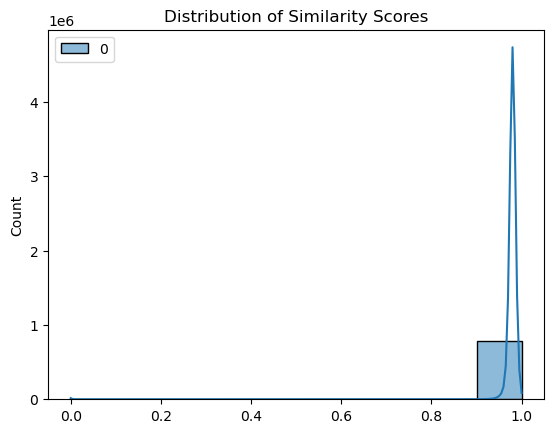

In [258]:
import seaborn as sns

# Density plot
sns.histplot(df_temporary_test, kde=True, bins=10, color='green')
plt.title('Distribution of Similarity Scores')
plt.show()

In [ ]:
articles_df

,article_id,title,subtitle,last_modified_time,premium,body,published_time,image_ids,article_type,url,...,entity_groups,topics,category,subcategory,category_str,total_inviews,total_pageviews,total_read_time,sentiment_score,sentiment_label
63777,8113223,Bengt Burgs store tv-sorg,Tv-kendissen gav for tre år siden et stort int...,2023-06-29 06:30:08,True,I 12 år var han ankermand på en af de største ...,2023-04-17 10:26:08,"[9723376, 9723405, 9723403, 9723391, 9723369]",article_default,https://ekstrabladet.dk/underholdning/bengt-bu...,...,"[PER, PER, ORG, PER, ORG, ORG, PROD, PER, PER,...","[Kendt, Underholdning, Film og tv]",414,[],underholdning,40638.0,16912.0,1323860.0,0.8872,Negative
83915,9232942,En ægte Dario er gået bort,Latinoen og smørtenoren har sunget og underhol...,2023-06-29 06:41:25,False,"Det er ikke mange mennesker, der skaber et beg...",2023-04-03 13:00:58,"[4626336, 9232886, 9232887, 7567959, 7806334, ...",article_default,https://ekstrabladet.dk/underholdning/dkkendte...,...,"[PROD, PER, LOC, MISC, PER, PER, ORG, PER, ORG...","[Kendt, Livsstil, Underholdning]",414,[425],underholdning,251397.0,29451.0,4352945.0,0.8485,Negative
87490,9321777,- Jeg måtte bare gøre noget,En forening af danske veteraner samler udstyr ...,2023-06-29 06:42:25,True,En camouflagefarvet firehjulstrækker kører ned...,2023-03-26 05:16:43,"[9687457, 9687451, 9687450, 9687454, 9687452, ...",article_default,https://ekstrabladet.dk/krimi/jeg-maatte-bare-...,...,"[LOC, LOC, LOC, ORG, ORG, LOC, ORG, PROD, ORG,...","[Konflikt og krig, Væbnet konflikt]",140,[],krimi,677524.0,27344.0,1994141.0,0.8126,Neutral
96757,9498911,Helmig kronet: Jeg er kongen,Ifølge Thomas Helmig selv regerer han i dansk ...,2023-06-29 06:45:05,False,"Der er vist bred enighed om, at Michael Jackso...",2023-03-25 10:46:30,"[9500351, 9669530, 9498934]",article_default,https://ekstrabladet.dk/musik/dkmusiknyt/helmi...,...,"[ORG, ORG, ORG, PER, PER, LOC, PER, PER, ORG, ...","[Kendt, Underholdning, Musik og lyd]",498,[500],musik,362566.0,77964.0,5736933.0,0.7359,Positive
99598,9539752,De danske cykelstjerners skattefidus,Stort overblik:,2023-07-26 14:41:32,True,default\nFlere af de danske cykelstjerner er s...,2023-04-08 07:50:20,"[9539969, 9703138, 9704157, 9539969, 9704164, ...",article_standard_feature,https://ekstrabladet.dk/sport/cykling/de-dansk...,...,"[LOC, PER, PROD, LOC, PER, LOC, MISC, MISC, PE...","[Sport, Cykling]",142,[317],sport,825594.0,34314.0,1812518.0,0.8997,Neutral
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
125535,9803492,Vilde billeder: Vulkan i udbrud i ferieparadis,Der er gang i vulkanen på Hawaiis største ø,2023-06-29 06:49:26,False,Det spyer med lava fra vulkanen Kilauea på Haw...,2023-06-08 05:49:20,"[9803493, 9803494, 9803495, 9803495, 9803494]",article_default,https://ekstrabladet.dk/nyheder/samfund/vilde-...,...,"[LOC, LOC, PER, ORG, ORG]","[Katastrofe, Vejr, Større katastrofe]",118,[133],nyheder,535989.0,100120.0,4112624.0,0.6095,Neutral
125536,9803505,Flyvende Antonsen knuser topspiller,"Verdens nummer syv, Chou Tien-Chen, fik ikke e...",2023-06-29 06:49:26,False,Anders Antonsen har holdt pause fra badmintonb...,2023-06-08 05:54:06,[9803516],article_default,https://ekstrabladet.dk/sport/anden_sport/badm...,...,"[PER, PROD, PER, PER, MISC, MISC, PER, PER, LO...","[Kendt, Begivenhed, Sport, Ketcher- og batspor...",142,"[327, 330]",sport,13320.0,959.0,55691.0,0.8884,Positive
125537,9803510,Nedschroef Langeskov udbetalte udbytte på toci...,Hos Nedschroef Langeskov ApS udbetalte man i d...,2023-06-29 06:49:26,False,Et udbytte på 30 millioner kroner blev i sidst...,2023-06-08 05:48:51,[9803509],article_default,https://ekstrabladet.dk/auto/magna/regnskaber/...,...,"[LOC, ORG, LOC, LOC, ORG, PER]","[Erhverv, Privat virksomhed, Økonomi]",2889,"[2890, 2900]",auto,12.0,1.0,25.0,0.8723,Negative
125538,9803525,"Dansk skuespiller: - Jeg nægtede, at jeg var syg",Julie R. Ølgaard fik akut kejsersnit og fødte ...,2023-06-2

In [267]:
articles_DF_2 = articles_df

In [280]:
#articles_DF_2.set_index('article_id', inplace=True)
articles_DF_2['premium'] = articles_DF_2['premium'].astype(int)  # True -> 1, False -> 0
articles_DF_2['sentiment_label'] = articles_DF_2['sentiment_label'].astype('category').cat.codes

In [281]:

import numpy as np
from sklearn.metrics.pairwise import cosine_similarity
from joblib import Parallel, delayed
from tqdm import tqdm  # Import tqdm for progress bar

# Selected columns to compare
selected_columns = ["premium",'total_inviews', 'total_pageviews', 'total_read_time', 'sentiment_label']

# Pre-calculate article data
articles_array = articles_DF_2[selected_columns].to_numpy()
article_id_to_index = {id_: idx for idx, id_ in enumerate(articles_DF_2.index)}

# Function to calculate similarity for a single row (user's article list)
def calculate_similarity_for_row(row, articles_array, article_id_to_index):
    tmp_list = []
    for tmp in range(len(row) - 1):
        current_id = row[tmp]
        next_id = row[tmp + 1]

        if current_id in article_id_to_index and next_id in article_id_to_index:
            row_1 = articles_array[article_id_to_index[current_id]]
            row_2 = articles_array[article_id_to_index[next_id]]
            
            print(row_1)
            

            similarity = cosine_similarity([row_1], [row_2])[0][0]
            tmp_list.append(similarity)
    

    return np.mean(tmp_list) if tmp_list else 0

# Function to parallelize the similarity calculation and store results
def calculate_similarity_for_all_rows(history_train, articles_array, article_id_to_index):
    # Dictionary to store similarity score for each user (row)
    similarity_scores = {}

    # Use tqdm to create a progress bar that tracks completion in parallel
    results = Parallel(n_jobs=-1)(
        delayed(calculate_similarity_for_row)(row, articles_array, article_id_to_index)
        for row in tqdm(history_train["article_id_fixed"][:100], desc="Processing rows")  # Wrap the iterable with tqdm
    )

    # Store the similarity scores in a dictionary with row index as the key
    for idx, score in enumerate(results):
        similarity_scores[idx] = score

    return similarity_scores

# Get similarity scores for all rows and print progress
similarity_scores_tmp = calculate_similarity_for_all_rows(history_train, articles_array, article_id_to_index)

# Print the similarity scores
print(similarity_scores_tmp)








Processing rows: 100%|██████████| 100/100 [00:01<00:00, 50.64it/s]


{0: 0.9860266903156404, 1: 0.990383891736886, 2: 0.9852956851342606, 3: 0.9920594603298989, 4: 0.9809035501462051, 5: 0.9903604386729963, 6: 0.9910458860225926, 7: 0.9896820909386362, 8: 0.9915340933258124, 9: 0.9882886834073491, 10: 0.9962347598509211, 11: 0.9942457312547223, 12: 0.9909196067613797, 13: 0.9925591721456495, 14: 0.9883733582229431, 15: 0.9917250625668219, 16: 0.9906441570280536, 17: 0.9945613954121154, 18: 0.9926045182535409, 19: 0.9884678946684404, 20: 0.9902063507124246, 21: 0.9920564306127554, 22: 0.9948665911981024, 23: 0.9923084693331975, 24: 0.993299608730497, 25: 0.994026222012783, 26: 0.9914247473427051, 27: 0.9928650530295435, 28: 0.9883258925615881, 29: 0.9920238952305879, 30: 0.9933157277770268, 31: 0.9889350335049635, 32: 0.9914039763739847, 33: 0.9936407841085998, 34: 0.9916977609259753, 35: 0.9915084963345805, 36: 0.9875094180876006, 37: 0.9927830320206583, 38: 0.9923484169541643, 39: 0.9905012205793176, 40: 0.9840644017197682, 41: 0.9917058433450003, 42: 

In [ ]:
articles_DF_2

,title,subtitle,last_modified_time,premium,body,published_time,image_ids,article_type,url,ner_clusters,entity_groups,topics,category,subcategory,category_str,total_inviews,total_pageviews,total_read_time,sentiment_score,sentiment_label
article_id,,,,,,,,,,,,,,,,,,,,
8113223,Bengt Burgs store tv-sorg,Tv-kendissen gav for tre år siden et stort int...,2023-06-29 06:30:08,1,I 12 år var han ankermand på en af de største ...,2023-04-17 10:26:08,"[9723376, 9723405, 9723403, 9723391, 9723369]",article_default,https://ekstrabladet.dk/underholdning/bengt-bu...,"[Bente Askjær Dirch Passsers, Carina Jensen, D...","[PER, PER, ORG, PER, ORG, ORG, PROD, PER, PER,...","[Kendt, Underholdning, Film og tv]",414,[],underholdning,5,6,8,0.8872,0
9232942,En ægte Dario er gået bort,Latinoen og smørtenoren har sunget og underhol...,2023-06-29 06:41:25,0,"Det er ikke mange mennesker, der skaber et beg...",2023-04-03 13:00:58,"[4626336, 9232886, 9232887, 7567959, 7806334, ...",article_default,https://ekstrabladet.dk/underholdning/dkkendte...,"[Angelique, Claudia, Danmark, Dario, Darios, E...","[PROD, PER, LOC, MISC, PER, PER, ORG, PER, ORG...","[Kendt, Livsstil, Underholdning]",414,[425],underholdning,8,8,15,0.8485,0
9321777,- Jeg måtte bare gøre noget,En forening af danske veteraner samler udstyr ...,2023-06-29 06:42:25,1,En camouflagefarvet firehjulstrækker kører ned...,2023-03-26 05:16:43,"[9687457, 9687451, 9687450, 9687454, 9687452, ...",article_default,https://ekstrabladet.dk/krimi/jeg-maatte-bare-...,"[Afghanistan, Caminoen, Danmark, DR, Ekstra Bl...","[LOC, LOC, LOC, ORG, ORG, LOC, ORG, PROD, ORG,...","[Konflikt og krig, Væbnet konflikt]",140,[],krimi,19,8,9,0.8126,1
9498911,Helmig kronet: Jeg er kongen,Ifølge Thomas Helmig selv regerer han i dansk ...,2023-06-29 06:45:05,0,"Der er vist bred enighed om, at Michael Jackso...",2023-03-25 10:46:30,"[9500351, 9669530, 9498934]",article_default,https://ekstrabladet.dk/musik/dkmusiknyt/helmi...,"[Beatbox Booking, EB, Ekstra Bladet, Johnny Ha...","[ORG, ORG, ORG, PER, PER, LOC, PER, PER, ORG, ...","[Kendt, Underholdning, Musik og lyd]",498,[500],musik,12,15,17,0.7359,2
9539752,De danske cykelstjerners skattefidus,Stort overblik:,2023-07-26 14:41:32,1,default\nFlere af de danske cykelstjerner er s...,2023-04-08 07:50:20,"[9539969, 9703138, 9704157, 9539969, 9704164, ...",article_standard_feature,https://ekstrabladet.dk/sport/cykling/de-dansk...,"[Andorra, Andreas Kron, Armstrong, Catalonien,...","[LOC, PER, PROD, LOC, PER, LOC, MISC, MISC, PE...","[Sport, Cykling]",142,[317],sport,20,9,9,0.8997,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9803492,Vilde billeder: Vulkan i udbrud i ferieparadis,Der er gang i vulkanen på Hawaiis største ø,2023-06-29 06:49:26,0,Det spyer med lava fra vulkanen Kilauea på Haw...,2023-06-08 05:49:20,"[9803493, 9803494, 9803495, 9803495, 9803494]",article_default,https://ekstrabladet.dk/nyheder/samfund/vilde-...,"[Hawaiis, Kilauea, Kilauea, Reuters, US Geolog...","[LOC, LOC, PER, ORG, ORG]","[Katastrofe, Vejr, Større katastrofe]",118,[133],nyheder,17,17,14,0.6095,1
9803505,Flyvende Antonsen knuser topspiller,"Verdens nummer syv, Chou Tien-Chen, fik ikke e...",2023-06-29 06:49:26,0,Anders Antonsen har holdt pause fra badmintonb...,2023-06-08 05:54:06,[9803516],article_default,https://ekstrabladet.dk/sport/anden_sport/badm...,"[Alexandra Bøje, All England, Amalie Magelund,...","[PER, PROD, PER, PER, MISC, MISC, PER, PER, LO...","[Kendt, Begivenhed, Sport, Ketcher- og batspor...",142,"[327, 330]",sport,5,5,5,0.8884,2
9803510,Nedschroef Langeskov udbetalte udbytte på toci...,Hos Nedschroef Langeskov ApS udbetalte man i d...,2023-06-29 06:49:26,0,Et udbytte på 30 millioner kroner blev i sidst...,2023-06-08 05:48:51,[9803509],article_default,https://ekstrabladet.dk/auto/magna/regnskaber/...,"[Bytoften, Erhvervsstyrelsen, Kerteminde Kommu...","[LOC, ORG, LOC, LOC, ORG, PER]","[Erhverv, Privat virksomhed, Økonomi]",2889,"[2890, 2900]",auto,1,1,1

In [44]:
#content based ML
articles_DF_2 = articles_df

In [45]:
articles_DF_2['title'] = articles_df['title'].str.lower()

In [46]:
list_body = articles_DF_2['title'].tolist()

In [47]:
list_body

['bengt burgs store tv-sorg',
 'en ægte dario er gået bort',
 '- jeg måtte bare gøre noget',
 'helmig kronet: jeg er kongen',
 'de danske cykelstjerners skattefidus',
 "danske sofia: dét sker der i 'private room'",
 "fbi's most wanted: kryptodronning ikke set i fem år",
 'buschaufføren: her er det vildeste, jeg har oplevet',
 'symptomerne, der kan snyde dig: fem lumske kræftformer',
 "svedte helt vildt: - 'jeg kunne ikke kramme min søn'",
 'taxachauffør: her er det vildeste, jeg har oplevet',
 'smid alt hvad du ejer efter denne skærm',
 'udforsk hinandens kroppe med japansk massage-teknik',
 '- det gjorde han bare ikke?',
 'dit helbreds bedste ven kan slå dig ihjel',
 'prima bolognese på ingen tid',
 'mysteriet om dan cooper',
 'det er ikke for at være høflig!',
 'nybagt mor: det skal du vide om amning',
 'sexlegetøj: til hende, ham og jer',
 'villy venter på demensdom: - jeg vader rundt i uvished',
 'så nemt smed janni 20 kilo',
 'genbrugspladsmedarbejderen: så vilde ting smider folk 

In [48]:
from sklearn.feature_extraction.text import CountVectorizer
from scipy.spatial import distance

vectorizer = CountVectorizer(lowercase=True)
X = vectorizer.fit_transform(list_body)
X.toarray()
count_vect_df = pd.DataFrame(X.toarray(),columns=vectorizer.get_feature_names_out())

In [ ]:
#distance.cdist(count_vect_df, count_vect_df, metric='euclidean').round(2)

In [50]:
import numpy as np
from scipy.spatial import distance
from sklearn.feature_extraction.text import CountVectorizer
import pandas as pd
from tqdm import tqdm

In [53]:
import numpy as np
from tqdm import tqdm
from scipy.spatial import distance

# Select the first 100 rows
subset = count_vect_df.iloc[:100]
num_rows = subset.shape[0]

# Initialize the matrix
distance_matrix = np.zeros((num_rows, num_rows))

# Compute distances row-by-row
for i in tqdm(range(num_rows), desc="Calculating distances"):
    row_1 = subset.iloc[[i]]  # Single row
    distances = distance.cdist(row_1, subset, metric='euclidean').round(2)
    distance_matrix[i] = distances  # Assign to the matrix

print(distance_matrix)


Calculating distances: 100%|██████████| 100/100 [00:00<00:00, 318.68it/s]

[[0.   3.32 3.16 ... 3.46 3.32 3.16]
 [3.32 0.   3.32 ... 3.32 3.46 3.32]
 [3.16 3.32 0.   ... 3.46 3.32 3.16]
 ...
 [3.46 3.32 3.46 ... 0.   3.61 3.46]
 [3.32 3.46 3.32 ... 3.61 0.   3.32]
 [3.16 3.32 3.16 ... 3.46 3.32 0.  ]]


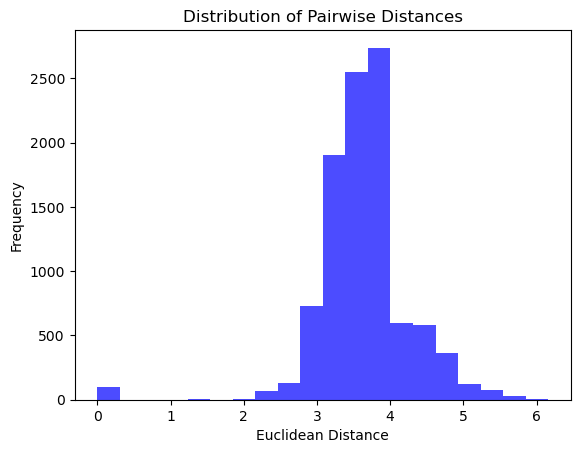

In [54]:
import matplotlib.pyplot as plt
import numpy as np

plt.hist(distance_matrix.flatten(), bins=20, color='blue', alpha=0.7)
plt.xlabel('Euclidean Distance')
plt.ylabel('Frequency')
plt.title('Distribution of Pairwise Distances')
plt.show()

In [55]:
from scipy.spatial import distance

# Example data: A subset of your dataframe (100 comparisons for simplicity)
subset = count_vect_df.iloc[:100]  # Adjust size if needed

# Compute cosine distance matrix
cosine_distance_matrix = distance.cdist(subset, subset, metric='cosine')

# Convert to similarity if desired
cosine_similarity_matrix = 1 - cosine_distance_matrix

# Round for better visualization
cosine_similarity_matrix = cosine_similarity_matrix.round(2)


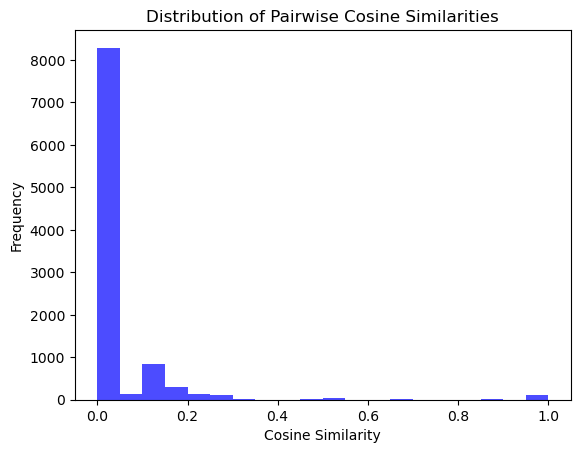

In [56]:
import matplotlib.pyplot as plt
import numpy as np

plt.hist(cosine_similarity_matrix.flatten(), bins=20, color='blue', alpha=0.7)
plt.xlabel('Cosine Similarity')
plt.ylabel('Frequency')
plt.title('Distribution of Pairwise Cosine Similarities')
plt.show()


In [57]:
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.metrics.pairwise import cosine_similarity
import pandas as pd

# Step 1: Vectorize the product classification features
count = CountVectorizer(stop_words='danish')  # Use Danish stopwords
count_matrix = count.fit_transform(df2['product_classification_features'].str.lower())  # Convert to lowercase

# Step 2: Compute cosine similarity matrix
cosine_sim = cosine_similarity(count_matrix, count_matrix)
cosine_sim_df = pd.DataFrame(cosine_sim)

# Step 3: Define the recommendation function
def content_recommendation_v1(title):
    a = df2.copy().reset_index().drop('index', axis=1)  # Create a working copy
    title = title.lower()  # Convert input to lowercase for consistency

    # Find the index of the given product title
    if title not in a['product'].str.lower().values:
        return f"Product '{title}' not found in the dataset."

    index = a[a['product'].str.lower() == title].index[0]

    # Get indices of top 10 similar products
    top_n_index = list(cosine_sim_df[index].nlargest(10).index)

    # Remove the title itself from the recommendations
    try:
        top_n_index.remove(index)
    except ValueError:
        pass

    # Create a DataFrame with recommendations
    similar_df = a.iloc[top_n_index][['product']]
    similar_df['cosine_similarity'] = cosine_sim_df.iloc[index, top_n_index].values

    return similar_df

# Example usage:
recommendations = content_recommendation_v1("produktnavn")
print(recommendations)

NameError: name 'df2' is not defined

In [59]:
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.metrics.pairwise import cosine_similarity
import pandas as pd

# Define a list of Danish stopwords
danish_stopwords = [
    "og", "i", "jeg", "det", "at", "en", "den", "til", "er", "som",
    "på", "de", "med", "han", "af", "for", "ikke", "der", "var", "mig",
    "sig", "men", "et", "har", "om", "vi", "min", "havde", "ham", "hun",
    "nu", "over", "da", "fra", "du", "ud", "sin", "dem", "os", "op", "man",
    "hans", "hvor", "eller", "hvad", "skal", "selv", "her", "alle", "vil",
    "blev", "kunne", "ind", "når", "være", "dog", "noget", "ville", "jo",
    "deres", "efter", "ned", "skulle", "denne", "end", "dette", "mit", "sådan",
    "thi", "jer", "nogle", "hos", "blive", "mange", "ad", "bliver", "hendes", "været"
]

# Ensure titles are lowercase
articles_DF_2['title'] = articles_DF_2['title'].str.lower()

# Step 1: Vectorize the article titles
count = CountVectorizer(stop_words=danish_stopwords)  # Use the custom Danish stopwords
count_matrix = count.fit_transform(articles_DF_2['title'])  # Use the 'title' column

# Step 2: Compute cosine similarity matrix
cosine_sim = cosine_similarity(count_matrix, count_matrix)
cosine_sim_df = pd.DataFrame(cosine_sim, index=articles_DF_2.index, columns=articles_DF_2.index)

# Step 3: Define the recommendation function
def content_recommendation_v3(title):
    title = title.lower()  # Convert input to lowercase for consistency

    # Check if the title exists in the DataFrame
    if title not in articles_DF_2['title'].values:
        return f"Title '{title}' not found in the dataset."

    # Find the index of the given title
    index = articles_DF_2[articles_DF_2['title'] == title].index[0]

    # Get indices of top 10 similar articles
    top_n_index = cosine_sim_df.loc[index].nlargest(10).index

    # Remove the title itself from the recommendations
    top_n_index = [idx for idx in top_n_index if idx != index]

    # Create a DataFrame with recommendations
    similar_df = articles_DF_2.loc[top_n_index, ['title']].copy()
    similar_df['cosine_similarity'] = cosine_sim_df.loc[index, top_n_index].values

    return similar_df

# Example usage:
recommendations = content_recommendation_v3("dansk madlavning opskrifter")
print(recommendations)


Title 'dansk madlavning opskrifter' not found in the dataset.


In [60]:
def content_recommendation_v3(title):
    # Ensure the dataset titles are lowercase and stripped of whitespace
    articles_DF_2['title'] = articles_DF_2['title'].str.lower().str.strip()

    # Convert the input title to lowercase and strip whitespace
    title = title.lower().strip()

    # Check if the title exists in the dataset
    if title not in articles_DF_2['title'].values:
        # Provide a more descriptive error message with available options
        return f"Title '{title}' not found in the dataset. Available titles: {articles_DF_2['title'].head().tolist()}"

    # Find the index of the given title
    index = articles_DF_2[articles_DF_2['title'] == title].index[0]

    # Get indices of top 10 similar articles
    top_n_index = cosine_sim_df.loc[index].nlargest(10).index

    # Remove the title itself from the recommendations
    top_n_index = [idx for idx in top_n_index if idx != index]

    # Create a DataFrame with recommendations
    similar_df = articles_DF_2.loc[top_n_index, ['title']].copy()
    similar_df['cosine_similarity'] = cosine_sim_df.loc[index, top_n_index].values

    return similar_df


In [61]:
print("Sample of Titles in Dataset:", articles_DF_2['title'].head(10).tolist())


Sample of Titles in Dataset: ['bengt burgs store tv-sorg', 'en ægte dario er gået bort', '- jeg måtte bare gøre noget', 'helmig kronet: jeg er kongen', 'de danske cykelstjerners skattefidus', "danske sofia: dét sker der i 'private room'", "fbi's most wanted: kryptodronning ikke set i fem år", 'buschaufføren: her er det vildeste, jeg har oplevet', 'symptomerne, der kan snyde dig: fem lumske kræftformer', "svedte helt vildt: - 'jeg kunne ikke kramme min søn'"]


In [62]:
recommendations = content_recommendation_v3('bengt burgs store tv-sorg')
print(recommendations)


                                                    title  cosine_similarity
115703                          tv-vært bengt burg er død           0.400000
117795  pas på, b&o: store producenter lancerer design-tv           0.365148
115759                     tv 2: hæver prisen på tv-pakke           0.338062
109463                               det så du ikke på tv           0.316228
109533                          - de er i store problemer           0.316228
107603   efter 15 år på skærmen: tv 2-ikon stopper med tv           0.298142
107640                                     tv-stjerne død           0.258199
107740                         skabte store spekulationer           0.258199
108257                               gjort til grin på tv           0.258199


In [73]:
count2 = CountVectorizer(stop_words='english',lowercase=True)
count_matrix2 = count2.fit_transform(behaviors_df['age'])
cosine_sim2 = cosine_similarity(count_matrix2, count_matrix2)
cosine_sim_df2 = pd.DataFrame(cosine_sim2)
def content_recommendation_v2(age):
    a = behaviors_df.copy().reset_index().drop('index',axis=1)
    index = a[a['age']==age].index[0]
    similar_basis_metric_1 = cosine_sim_df[cosine_sim_df[index]>0][index].reset_index().rename(columns={index:'sim_1'})
    similar_basis_metric_2 = cosine_sim_df2[cosine_sim_df2[index]>0][index].reset_index().rename(columns={index:'sim_2'})
    similar_df = similar_basis_metric_1.merge(similar_basis_metric_2,how='left').merge(a[['age']].reset_index(),how='left')
    similar_df['sim'] = similar_df[['sim_1','sim_2']].fillna(0).mean(axis=1)
    similar_df = similar_df[similar_df['index']!=index].sort_values(by='sim',ascending=False)
    return similar_df[['age','sim']].head(10)

AttributeError: 'float' object has no attribute 'lower'

In [75]:
behaviors_df.head(3)

,impression_id,article_id,impression_time,read_time,scroll_percentage,device_type,article_ids_inview,article_ids_clicked,user_id,is_sso_user,gender,postcode,age,is_subscriber,session_id,next_read_time,next_scroll_percentage
23070,1265419,9776420.0,2023-05-23 12:30:42,122.0,100.0,2,"[9777374, 9777648, 9777693, 9777319, 9777190, ...",[9776710],481542,1,0.0,0.0,40.0,1,5005297,17.0,14.0
23101,1265650,9777190.0,2023-05-23 12:06:25,119.0,100.0,1,"[9773574, 9759955, 9775908, 9777299, 9777319, ...",[9777026],489878,1,0.0,3.0,50.0,1,5011577,52.0,100.0
23102,1265651,9777319.0,2023-05-23 12:05:23,54.0,100.0,1,"[9777345, 9695287, 9761920, 9777190, 9777374, ...",[9777374],489878,1,0.0,3.0,50.0,1,5011577,7.0,100.0


In [76]:
articles_df.head(3)

,article_id,title,subtitle,last_modified_time,premium,body,published_time,image_ids,article_type,url,...,entity_groups,topics,category,subcategory,category_str,total_inviews,total_pageviews,total_read_time,sentiment_score,sentiment_label
63777,8113223,bengt burgs store tv-sorg,Tv-kendissen gav for tre år siden et stort int...,2023-06-29 06:30:08,True,I 12 år var han ankermand på en af de største ...,2023-04-17 10:26:08,"[9723376, 9723405, 9723403, 9723391, 9723369]",article_default,https://ekstrabladet.dk/underholdning/bengt-bu...,...,"[PER, PER, ORG, PER, ORG, ORG, PROD, PER, PER,...","[Kendt, Underholdning, Film og tv]",414,[],underholdning,40638.0,16912.0,1323860.0,0.8872,Negative
83915,9232942,en ægte dario er gået bort,Latinoen og smørtenoren har sunget og underhol...,2023-06-29 06:41:25,False,"Det er ikke mange mennesker, der skaber et beg...",2023-04-03 13:00:58,"[4626336, 9232886, 9232887, 7567959, 7806334, ...",article_default,https://ekstrabladet.dk/underholdning/dkkendte...,...,"[PROD, PER, LOC, MISC, PER, PER, ORG, PER, ORG...","[Kendt, Livsstil, Underholdning]",414,[425],underholdning,251397.0,29451.0,4352945.0,0.8485,Negative
87490,9321777,- jeg måtte bare gøre noget,En forening af danske veteraner samler udstyr ...,2023-06-29 06:42:25,True,En camouflagefarvet firehjulstrækker kører ned...,2023-03-26 05:16:43,"[9687457, 9687451, 9687450, 9687454, 9687452, ...",article_default,https://ekstrabladet.dk/krimi/jeg-maatte-bare-...,...,"[LOC, LOC, LOC, ORG, ORG, LOC, ORG, PROD, ORG,...","[Konflikt og krig, Væbnet konflikt]",140,[],krimi,677524.0,27344.0,1994141.0,0.8126,Neutral


In [77]:
history_df.head(3)

,user_id,impression_time_fixed,scroll_percentage_fixed,article_id_fixed,read_time_fixed
0,10029,"DatetimeIndex(['2023-04-28 06:16:57', '2023-04...","[23.0, 69.0, 27.0, nan, 47.0, 38.0, 100.0, 12....","[9735579, 9739888, 9739471, 9739864, 9738441, ...","[28.0, 24.0, 11.0, 107.0, 8.0, 7.0, 20.0, 5.0,..."
1,10033,"DatetimeIndex(['2023-04-27 11:11:32', '2023-04...","[33.0, 41.0, 33.0, 100.0, 68.0, 38.0, 1.0, 58....","[9738139, 9738263, 9738139, 9738760, 9738777, ...","[2.0, 2.0, 718.0, 18.0, 26.0, 78.0, 3.0, 11.0,..."
2,10034,"DatetimeIndex(['2023-04-30 09:46:57', '2023-04...","[nan, 88.0, 27.0, nan, 23.0, 100.0, 100.0, 22....","[9742693, 9742686, 9744016, 9743818, 9744922, ...","[21.0, 103.0, 28.0, 0.0, 5.0, 34.0, 14.0, 14.0..."


In [78]:
import pandas as pd
import numpy as np
from sklearn.metrics.pairwise import cosine_similarity

# Sample dataset (assuming you've already loaded 'history_df')
# history_df = pd.read_csv("your_dataset.csv")  # Example load

# Step 1: Create a list of unique article IDs from all users
all_article_ids = set([article_id for sublist in history_df['article_id_fixed'] for article_id in sublist])

# Step 2: Convert article_id_fixed for each user to a binary vector
# Each index corresponds to whether the article was read or not
def create_article_vector(user_article_ids, all_article_ids):
    return [1 if article_id in user_article_ids else 0 for article_id in all_article_ids]

# Apply this function to all users and create a dataframe of user vectors
user_vectors = []
for index, row in history_df.iterrows():
    user_article_ids = row['article_id_fixed']
    user_vectors.append(create_article_vector(user_article_ids, all_article_ids))

# Create a dataframe where each row is a user and each column corresponds to an article
user_article_matrix = pd.DataFrame(user_vectors, columns=all_article_ids)

# Step 3: Calculate the cosine similarity between the first user and all other users
user_1_vector = user_article_matrix.iloc[0].values.reshape(1, -1)  # First user's article vector

# Compute cosine similarity
cosine_similarities = cosine_similarity(user_1_vector, user_article_matrix)

# Convert the similarities to a pandas Series for better readability
cosine_similarities_series = pd.Series(cosine_similarities[0], index=history_df['user_id'])

# Sort the similarities to see the most similar users
similar_users = cosine_similarities_series.sort_values(ascending=False)

# Display the top similar users (excluding the first user)
print(similar_users.head(10))  # Adjust the number of users displayed as needed


KeyboardInterrupt: 

In [81]:
history_train.shape

(785067, 5)

In [61]:
import pandas as pd
from tqdm import tqdm

# Sample DataFrame (assuming history_df is already loaded)
# history_df = pd.read_csv("your_dataset.csv")  # Example load

# Initialize an empty dictionary to store article IDs as keys and lists of users as values
article_user_dict = {}

# Use tqdm to show progress while iterating through the dataframe rows
for index, row in tqdm(history_df.iterrows(), total=len(history_df), desc="Processing users"):
    user_id = row['user_id']
    article_ids = row['article_id_fixed']  # List of article IDs for this user
    
    # Iterate through the list of article IDs
    for article_id in article_ids:
        if article_id not in article_user_dict:
            article_user_dict[article_id] = []  # Initialize the list if article_id is not in the dictionary
        article_user_dict[article_id].append(user_id)  # Append the user_id to the article's list


Processing users: 100%|██████████| 788090/788090 [00:55<00:00, 14322.76it/s]


In [ ]:
history_df.user_id[0]

10029

In [38]:
# Group the DataFrame by 'age' and collect 'user_id' for each group
age_user_dict = behavior_train.groupby('age')['user_id'].apply(list).to_dict()

# Group the DataFrame by 'age' and collect 'user_id' for each group
is_sub_user_dict = behavior_train.groupby('is_subscriber')['user_id'].apply(list).to_dict()

# Group the DataFrame by 'age' and collect 'user_id' for each group
device_user_dict = behavior_train.groupby('device_type')['user_id'].apply(list).to_dict()


In [ ]:
target_user_id = history_df.user_id[0]

# Assuming the target user's profile is defined
#behavior_train = behavior_train.set_index('user_id')

target_user = behavior_train.iloc[target_user_id]

# Extract the target user's profile (age, subscription status, device type)
target_age = target_user['age']
target_is_sub = target_user['is_subscriber']
target_device_type = target_user['device_type']


In [55]:
filter_1 = age_user_dict = behavior_train[behavior_train['age'] == target_age]
filter_2 = is_sub_user_dict = filter_1[filter_1["is_subscriber"] == target_is_sub]
filter_3 = device_user_dict = filter_2[filter_2["device_type"] == target_device_type]

In [ ]:
from itertools import chain

target_article = history_df['article_id_fixed'][0]
target_similar_articles = set()

# Loop through each article in article_user_dict
for article_id in target_article:
    target_similar_articles.update(article_user_dict[article_id])


In [83]:
filtered_target_similar_articles = list()

for i in filter_3.index:
    if i in target_similar_articles:
        filtered_target_similar_articles.append(i)


In [87]:
len(filtered_target_similar_articles)

1973

In [88]:
target_article

array([9735579, 9739888, 9739471, 9739864, 9738441, 9739883, 9739153,
       9739844, 9739634, 9739802, 9647575, 9739597, 9739640, 9736662,
       9740427, 9740223, 9740013, 9740432, 9740356, 9740484, 9740174,
       9241111, 9740182, 9740323, 9740405, 9740249, 9740106, 9740236,
       9738800, 9739938, 9738949, 9740969, 9740957, 9740962, 9740749,
       9740853, 9740843, 9740905, 9738585, 9741449, 9741476, 9741428,
       9741360, 9741106, 9741311, 9740903, 9738801, 9741772, 9741728,
       9741218, 9741578, 9741589, 9741415, 9739272, 9742675, 9740408,
       9742675, 9667501, 9742675, 9742627, 9742675, 9742675, 9742586,
       9742675, 9742225, 9742675, 9742625, 9742675, 9741997, 9742675,
       9742634, 9742675, 9741144, 9742675, 9742619, 9742675, 9742172,
       9742675, 9740324, 9742675, 9742509, 9742675, 9742270, 9742675,
       9742675, 9742560, 9742675, 9742635, 9742748, 9742693, 9733616,
       9742681, 9740576, 9743090, 9736862, 9735166, 9742173, 9742885,
       9743002, 9743

In [93]:
filtered_target_similar_articles[0]

2297234

In [96]:
history_df = history_df.set_index("user_id")

In [98]:
history_df.loc[filtered_target_similar_articles[0]]["article_id_fixed"]

array([9738105, 9739344, 9739342, 9739344, 9739333, 9738947, 9739362,
       9738947, 9739286, 9738947, 9739398, 9738947, 9739333, 9738947,
       9739205, 9739411, 9636444, 9738660, 9636444, 6998758, 9636444,
       9738855, 9636444, 9739202, 9737393, 9739202, 9739283, 9739202,
       9739035, 9739202, 9735393, 9739202, 9739164, 9739202, 9737266,
       9739202, 9738902, 9739443, 9740174, 9740747, 9740710, 9740182,
       9740710, 9740332, 9740710, 9740013, 9740710, 9740484, 9740843,
       9740662, 9740485, 9741958, 9740324, 9742268, 9740324, 9742161,
       9742188, 9740383, 9742279, 9740610, 9742279, 9740383, 9742188,
       9742161, 9740324, 9741958, 9742635, 9671904, 9740576, 9736862,
       9742793, 9743090, 9743298, 9742173, 9743298, 9742885, 9740894,
       9744260, 9744260, 9696204, 9744034, 9736809, 9744034, 9744193,
       9744193, 9744119, 9744193, 9744193, 9743934, 9744216, 9743934,
       9743846, 9744070, 9746364, 9746187, 9676294, 9744341, 9746364,
       9744341, 9745

In [99]:
from sklearn.metrics.pairwise import cosine_similarity
import numpy as np

In [175]:
similarity_results = []

for i in range(len(filtered_target_similar_articles)):
    if len(history_df.loc[filtered_target_similar_articles[i]]["article_id_fixed"]) < len(target_article):
        cos_sim = cosine_similarity([history_df.loc[filtered_target_similar_articles[i]]["article_id_fixed"][:len(history_df.loc[filtered_target_similar_articles[i]]["article_id_fixed"])]], [target_article[:len(history_df.loc[filtered_target_similar_articles[i]]["article_id_fixed"])]])

        similarity_results.append((filtered_target_similar_articles[i], cos_sim[0]))

similarity_df = pd.DataFrame(similarity_results, columns=["user_id", "cosine_similarity"])
similarity_df = similarity_df.sort_values(by="cosine_similarity", ascending=False)

similarity_df.head(5)

,user_id,cosine_similarity
517,1672615,[0.9999999801654906]
1647,1672615,[0.9999999801654906]
1586,39024,[0.9999976687837052]
739,39024,[0.9999976687837052]
954,2141513,[0.999997533501723]


In [177]:
similarity_df["cosine_similarity"] = similarity_df["cosine_similarity"].apply(tuple)
similarity_df = similarity_df.drop_duplicates()

In [178]:
similarity_df.head(5)

,user_id,cosine_similarity
517,1672615,"(0.9999999801654906,)"
1586,39024,"(0.9999976687837052,)"
954,2141513,"(0.999997533501723,)"
83,1443711,"(0.999997371409589,)"
424,1444733,"(0.999997025593117,)"


In [137]:
print("main", target_article[3], "target y value: ", target_article[4])

main 9739864 target y value:  9738441


In [187]:
np.where(target_article == 9766040)

(array([551, 576], dtype=int64),)

In [191]:
target_article[577]

9757972

In [181]:
history_df.loc[1443711]["article_id_fixed"]

array([9748158, 9748158, 9748140, 9746170, 9756362, 9755964, 9755726,
       9755964, 9755010, 9754536, 9755897, 9756317, 9755897, 9759398,
       9766042, 9766040, 9766042])

In [121]:
filtered_target_similar_articles[i]

691305

In [108]:
cos_sim

array([[0.99986558]])

In [111]:
filtered_target_similar_articles[1]

691305

In [117]:
articles_df

,article_id,title,subtitle,last_modified_time,premium,body,published_time,image_ids,article_type,url,...,entity_groups,topics,category,subcategory,category_str,total_inviews,total_pageviews,total_read_time,sentiment_score,sentiment_label
63777,8113223,Bengt Burgs store tv-sorg,Tv-kendissen gav for tre år siden et stort int...,2023-06-29 06:30:08,True,I 12 år var han ankermand på en af de største ...,2023-04-17 10:26:08,"[9723376, 9723405, 9723403, 9723391, 9723369]",article_default,https://ekstrabladet.dk/underholdning/bengt-bu...,...,"[PER, PER, ORG, PER, ORG, ORG, PROD, PER, PER,...","[Kendt, Underholdning, Film og tv]",414,[],underholdning,40638.0,16912.0,1323860.0,0.8872,Negative
83915,9232942,En ægte Dario er gået bort,Latinoen og smørtenoren har sunget og underhol...,2023-06-29 06:41:25,False,"Det er ikke mange mennesker, der skaber et beg...",2023-04-03 13:00:58,"[4626336, 9232886, 9232887, 7567959, 7806334, ...",article_default,https://ekstrabladet.dk/underholdning/dkkendte...,...,"[PROD, PER, LOC, MISC, PER, PER, ORG, PER, ORG...","[Kendt, Livsstil, Underholdning]",414,[425],underholdning,251397.0,29451.0,4352945.0,0.8485,Negative
87490,9321777,- Jeg måtte bare gøre noget,En forening af danske veteraner samler udstyr ...,2023-06-29 06:42:25,True,En camouflagefarvet firehjulstrækker kører ned...,2023-03-26 05:16:43,"[9687457, 9687451, 9687450, 9687454, 9687452, ...",article_default,https://ekstrabladet.dk/krimi/jeg-maatte-bare-...,...,"[LOC, LOC, LOC, ORG, ORG, LOC, ORG, PROD, ORG,...","[Konflikt og krig, Væbnet konflikt]",140,[],krimi,677524.0,27344.0,1994141.0,0.8126,Neutral
96757,9498911,Helmig kronet: Jeg er kongen,Ifølge Thomas Helmig selv regerer han i dansk ...,2023-06-29 06:45:05,False,"Der er vist bred enighed om, at Michael Jackso...",2023-03-25 10:46:30,"[9500351, 9669530, 9498934]",article_default,https://ekstrabladet.dk/musik/dkmusiknyt/helmi...,...,"[ORG, ORG, ORG, PER, PER, LOC, PER, PER, ORG, ...","[Kendt, Underholdning, Musik og lyd]",498,[500],musik,362566.0,77964.0,5736933.0,0.7359,Positive
99598,9539752,De danske cykelstjerners skattefidus,Stort overblik:,2023-07-26 14:41:32,True,default\nFlere af de danske cykelstjerner er s...,2023-04-08 07:50:20,"[9539969, 9703138, 9704157, 9539969, 9704164, ...",article_standard_feature,https://ekstrabladet.dk/sport/cykling/de-dansk...,...,"[LOC, PER, PROD, LOC, PER, LOC, MISC, MISC, PE...","[Sport, Cykling]",142,[317],sport,825594.0,34314.0,1812518.0,0.8997,Neutral
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
125535,9803492,Vilde billeder: Vulkan i udbrud i ferieparadis,Der er gang i vulkanen på Hawaiis største ø,2023-06-29 06:49:26,False,Det spyer med lava fra vulkanen Kilauea på Haw...,2023-06-08 05:49:20,"[9803493, 9803494, 9803495, 9803495, 9803494]",article_default,https://ekstrabladet.dk/nyheder/samfund/vilde-...,...,"[LOC, LOC, PER, ORG, ORG]","[Katastrofe, Vejr, Større katastrofe]",118,[133],nyheder,535989.0,100120.0,4112624.0,0.6095,Neutral
125536,9803505,Flyvende Antonsen knuser topspiller,"Verdens nummer syv, Chou Tien-Chen, fik ikke e...",2023-06-29 06:49:26,False,Anders Antonsen har holdt pause fra badmintonb...,2023-06-08 05:54:06,[9803516],article_default,https://ekstrabladet.dk/sport/anden_sport/badm...,...,"[PER, PROD, PER, PER, MISC, MISC, PER, PER, LO...","[Kendt, Begivenhed, Sport, Ketcher- og batspor...",142,"[327, 330]",sport,13320.0,959.0,55691.0,0.8884,Positive
125537,9803510,Nedschroef Langeskov udbetalte udbytte på toci...,Hos Nedschroef Langeskov ApS udbetalte man i d...,2023-06-29 06:49:26,False,Et udbytte på 30 millioner kroner blev i sidst...,2023-06-08 05:48:51,[9803509],article_default,https://ekstrabladet.dk/auto/magna/regnskaber/...,...,"[LOC, ORG, LOC, LOC, ORG, PER]","[Erhverv, Privat virksomhed, Økonomi]",2889,"[2890, 2900]",auto,12.0,1.0,25.0,0.8723,Negative
125538,9803525,"Dansk skuespiller: - Jeg nægtede, at jeg var syg",Julie R. Ølgaard fik akut kejsersnit og fødte ...,2023-06-2